In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

from collections import Counter
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn.feature_selection import chi2, mutual_info_classif
from sklearn.neighbors import KNeighborsClassifier
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory
from itertools import product

In [3]:
df = pd.read_excel('dataset/Data 1.xlsx', names=['comment', 'polarity'])
df.shape

(152, 2)

In [4]:
df.head()

,comment,polarity
0,min bnyk yg kecewa lo dgn update terbaru alih ...,1
1,user id password mesti ke bank ya gpplah yg pe...,1
2,saat transfer kadang ada muncul keterangan kon...,1
3,begitu saya update dan no tlpn saya statusnya ...,1
4,tolong tambahkan fitur fingerprint atau face r...,1


## Preprocessing

<ol>
    <li>Case folding <b>(done at previous notebook)</b></li>
    <li>Cleansing <b>(done at previous notebook)</b></li>
    <li>Formalization</li>
    <li>Stemming</li>
    <li>Stopword Removal</li>
    <li>Tokenizing</li>
</ol>
    

### Formalization (Manual)

In [5]:
formal_dict = {}
with open('resources/formalization_dict.txt', 'r') as file:
    i = 1
    for row in file:
        old, new = row.split('\t')
        i += 1
        formal_dict[old] = new.lower().strip()

print(f'There are {len(formal_dict)} token pairs')

There are 51 token pairs


In [6]:
formal_comment = []

for comment in df.comment:
    sentence = ' '+comment+' '
    for false_word, true_word in formal_dict.items():
        word = ' '+false_word+' '
        sentence = sentence.replace(word, ' '+true_word+' ')
    formal_comment.append(sentence)
    
print(f'We have {len(formal_comment)} comments')

We have 152 comments


### Stemming (Sastrawi)

In [7]:
stemmer = StemmerFactory().create_stemmer()
comment_stemmed = [stemmer.stem(formal_comment[i]) for i in range(df.shape[0])]

comment_stemmed[0]

'min bnyk yang kecewa lo dengan update baru alih alih sempurna malah susah nasabah mandiri masuk saya agar kurang tindak tipu jahat waktu ada transaksi yang lebih rb rp maka bisa di tambah security upa kirim nomor verifikasi yang kirim ke nomor hp sms banking trus harus di masuk dalam applikasi mandiri online agar benar bahwa si nasabah sedang laku transaksi dengan demikian pasti tetap aman mohon perhati ya min terimakasih'

In [8]:
formal_comment[0]

' min bnyk yang kecewa lo dengan update terbaru alih alih penyempurnaan malah menyusahkan nasabah mandiri masukan saya agar mengurangi tindak penipuan kejahatan sewaktu ada transaksi yang lebih rb rp maka bisa di tambahkan security berupa pengiriman nomor verifikasi yang dikirimkan ke nomor hp sms banking trus harus di masukkan dalam applikasi mandiri online agar benar bahwa si nasabah sedang melakukan transaksi dengan demikian pasti tetap aman mohon diperhatikan ya min terimakasih '

### Stopwords Removal (Manual)

In [34]:
def remove_token(bad_token, dataset):
    clean_dataset = []
    for comment in dataset:
        comment = ' '+comment+' '
        for token in bad_token:
            word = ' '+token+' '
            comment = comment.replace(word, ' ')
        
        clean_dataset.append(comment.strip())
    
    assert len(dataset) == len(clean_dataset)
    
    return np.array(clean_dataset)

In [9]:
stopwords = [
    'yang', 'untuk', 'pada', 'antara', 'dan' , 'di', 'dari', 'hal', 
    'dalam', 'atau', 'kah', 'pun', 'dsb', 'dst', 'dll', 'toh', 'ya',
    'saya', 'dengan', 'nya', 'ke', 'si', 'dah'
]

print(f'There are {len(stopwords)} stopword list')

There are 23 stopword list


In [10]:
clean_comment = []
for comment in comment_stemmed:
    for token in stopwords:
        word = ' '+token+' '
        comment = comment.replace(word, ' ')
    if sentence.strip():
        clean_comment.append(comment.strip())
        
print(f'We have {len(clean_comment)} comments')

We have 152 comments


In [11]:
clean_comment[0]

'min bnyk kecewa lo update baru alih alih sempurna malah susah nasabah mandiri masuk agar kurang tindak tipu jahat waktu ada transaksi lebih rb rp maka bisa tambah security upa kirim nomor verifikasi kirim nomor hp sms banking trus harus masuk applikasi mandiri online agar benar bahwa nasabah sedang laku transaksi demikian pasti tetap aman mohon perhati min terimakasih'

### Tokenizing

In [84]:
features = np.array([np.array(comment.split()) for comment in clean_comment])
features[:2]

array([array(['min', 'bnyk', 'kecewa', 'lo', 'update', 'baru', 'alih', 'alih',
       'sempurna', 'malah', 'susah', 'nasabah', 'mandiri', 'masuk',
       'agar', 'kurang', 'tindak', 'tipu', 'jahat', 'waktu', 'ada',
       'transaksi', 'lebih', 'rb', 'rp', 'maka', 'bisa', 'tambah',
       'security', 'upa', 'kirim', 'nomor', 'verifikasi', 'kirim',
       'nomor', 'hp', 'sms', 'banking', 'trus', 'harus', 'masuk',
       'applikasi', 'mandiri', 'online', 'agar', 'benar', 'bahwa',
       'nasabah', 'sedang', 'laku', 'transaksi', 'demikian', 'pasti',
       'tetap', 'aman', 'mohon', 'perhati', 'min', 'terimakasih'],
      dtype='<U11'),
       array(['user', 'id', 'password', 'mesti', 'bank', 'gpplah', 'penting',
       'aman', 'transaksi'], dtype='<U9')], dtype=object)

## Modelling

### KNN

<h3>Important</h3>
<ol>
    <li>ngram_range</li>
    <li>max_df: occurred in too many documents(common word)</li>
    <li>min_df: occurred in too few documents (typo, alay)</li>
    <li>n_neighbors: occurred in too few documents (typo, alay)</li>
    <li>weights: weight function used in prediction. Possible values:
        <ul>
            <li>‘uniform’ : uniform weights. All points in each neighborhood are weighted equally.</li>
            <li>‘distance’ : weight points by the inverse of their distance. in this case, closer neighbors of a query point will have a greater influence than neighbors which are further away.</li>
        </ul>
    </li>
    <li>metric: the distance metric to use</li>
</ol>

In [36]:
ngram = [(1, 1), (1, 2), (1, 3)]
min_df = [0.0, .1, .2, .3]
max_df = [.5, .6, .7 , .8, .9, 1.0]
num_k = [*range(1, 22)]
weight = ['uniform', 'distance']
measurement_method = ['manhattan', 'euclidean', 'cosine']

param_combinations = list(product(ngram, min_df, max_df, num_k, weight, measurement_method))
param_combinations[:3]

[((1, 1), 0.0, 0.5, 1, 'uniform', 'manhattan'),
 ((1, 1), 0.0, 0.5, 1, 'uniform', 'euclidean'),
 ((1, 1), 0.0, 0.5, 1, 'uniform', 'cosine')]

In [37]:
NUM_BATCHES = 5
features = np.array(clean_comment)
labels = np.array(df.polarity)
train_eval, test_eval = [], []

for i in range(NUM_BATCHES):

    train_idx = np.load(f'dataset/train_{i+1}.npy')
    test_idx = np.load(f'dataset/test_{i+1}.npy')
    train_labels = labels[train_idx]
    test_labels = labels[test_idx]
    
    for param in param_combinations:
        tfidf_vectorizer = TfidfVectorizer(ngram_range=param[0], min_df=param[1], max_df=param[2])
        train_features = tfidf_vectorizer.fit_transform(features[train_idx])
        test_features = tfidf_vectorizer.transform(features[test_idx])
        
        # train and evaluate
        clf = KNeighborsClassifier(n_neighbors=param[3], weights=param[4], metric=param[5])
        clf.fit(train_features, train_labels)
        train_acc = clf.score(train_features, train_labels)
        test_acc = clf.score(test_features, test_labels)
        
        train_eval.append(train_acc)
        test_eval.append(test_acc)
        
print('Train and evaluate model completed')

Train and evaluate model completed


In [38]:
NUM_PARAMS = len(param_combinations)
train_history = [[] for i in range(NUM_PARAMS)]
test_history = [[] for i in range(NUM_PARAMS)]

for i in range(len(train_eval)):
    idx = i % NUM_PARAMS
    train_history[idx].append(train_eval[i])
    test_history[idx].append(test_eval[i])

# append the average accuracy
for i in range(NUM_PARAMS):
    train_history[i].append(sum(train_history[i])/NUM_BATCHES)
    test_history[i].append(sum(test_history[i])/NUM_BATCHES)

if len(train_history[-1]) == NUM_BATCHES+1:
    print('Done')

Done


In [39]:
eval_history = {}
for i in range(NUM_PARAMS):
    eval_history[f'Train Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]})'] = train_history[i] 
    eval_history[f'Test Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]})'] = test_history[i]
    
history_tfidf = pd.DataFrame(eval_history, index=['Batch-1', 'Batch-2', 'Batch-3', 
                                                  'Batch-4', 'Batch-5', 'Average'])
history_tfidf

,"Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=euclidean)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=euclidean)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=cosine)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=cosine)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=distance, distance=manhattan)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=distance, distance=manhattan)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=distance, distance=euclidean)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=distance, distance=euclidean)",...,"Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=uniform, distance=euclidean)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=uniform, distance=euclidean)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=uniform, distance=cosine)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=uniform, distance=cosine)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=manhattan)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=manhattan)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=euclidean)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=euclidean)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine)"
Batch-1,1.000000,0.419355,1.000000,0.612903,1.000000,0.612903,1.000000,0.419355,1.000000,0.612903,...,0.809917,1.000000,0.818182,1.000000,0.909091,0.903226,0.909091,0.935484,0.909091,0.935484
Batch-2,0.983471,0.580645,0.983471,0.806452,0.983471,0.806452,0.983471,0.580645,0.983471,0.806452,...,0.818182,0.903226,0.818182,0.903226,0.900826,0.967742,0.900826,0.967742,0.900826,0.967742
Batch-3,0.983607,0.500000,0.983607,0.800000,0.983607,0.800000,0.983607,0.500000,0.983607,0.800000,...,0.852459,0.933333,0.852459,0.933333,0.909836,0.933333,0.909836,0.933333,0.909836,0.933333
Batch-4,0.991803,0.533333,0.991803,0.733333,0.991803,0.733333,0.991803,0.533333,0.991803,0.733333,...,0.844262,0.866667,0.844262,0.866667,0.918033,0.933333,0.918033,0.933333,0.918033,0.933333
Batch-5,0.991803,0.433333,0.991803,0.366667,0.991803,0.366667,0.991803,0.433333,0.991803,0.366667,...,0.918033,0.566667,0.918033,0.566667,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000
Average,0.990137,0.493333,0.990137,0.663871,0.990137,0.663871,0.990137,0.493333,0.990137,0.663871,...,0.848571,0.853978,0.850224,0.853978,0.922639,0.867527,0.922639,0.873978,0.922639,0.873978


In [40]:
test_col = [col for col in history_tfidf.columns if col.startswith('Test')]
test_col[history_tfidf.loc['Average', test_col].argmax()]

'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan)'

In [56]:
history_tfidf[['Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan)', 'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan)']]

,"Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan)","Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan)"
Batch-1,0.909091,0.935484
Batch-2,0.900826,0.967742
Batch-3,0.909836,0.933333
Batch-4,0.918033,0.933333
Batch-5,0.975410,0.600000
Average,0.922639,0.873978



We got <b>the best result</b> from KNN Model with 
<b>minimum</b> of word's occurrences is <b>30%</b> of total documents, 
<b>maximum</b> of word's occurrences is <b>50%</b> of total documents, 
<b>only use 1 gram</b>,
<b>number of neighbors = 18</b>,
<b>distance of weight function</b>,
and using <b>manhattan distance</b> for measure the simmilarities,
that is: <h3>87.40%</h3>

### KNN +  Information Gain + TF-IDF

In [41]:
ngram = [(1, 1), (1, 2), (1, 3)]
min_df = [0.0, .1, .2, .3]
max_df = [.5, .6, .7 , .8, .9, 1.0]
num_k = [*range(1, 22)]
weight = ['uniform', 'distance']
measurement_method = ['manhattan', 'euclidean', 'cosine']
ig_tresh = [1e-2, 1e-3, 1e-4, 1e-100]

param_combinations = list(product(ngram, min_df, max_df, num_k, weight, measurement_method, ig_tresh))
param_combinations[:3]

[((1, 1), 0.0, 0.5, 1, 'uniform', 'manhattan', 0.01),
 ((1, 1), 0.0, 0.5, 1, 'uniform', 'manhattan', 0.001),
 ((1, 1), 0.0, 0.5, 1, 'uniform', 'manhattan', 0.0001)]

In [42]:
len(param_combinations)

36288

In [43]:
NUM_BATCHES = 5
features = np.array(clean_comment)
labels = np.array(df.polarity)
train_eval, test_eval = [], []

for i in range(NUM_BATCHES):

    train_idx = np.load(f'dataset/train_{i+1}.npy')
    test_idx = np.load(f'dataset/test_{i+1}.npy')
    train_labels = labels[train_idx]
    test_labels = labels[test_idx]
    
    vectorizer = CountVectorizer()
    train_count_features = vectorizer.fit_transform(features[train_idx])
    test_count_features = vectorizer.transform(features[test_idx])

    ig_res = dict(zip(vectorizer.get_feature_names(),
                      mutual_info_classif(train_count_features, train_labels, discrete_features=True)
                   ))
    ig_res = sorted(ig_res.items(), key=lambda x: x[1], reverse=True)
    
    for param in param_combinations:
        below_tresh = [ig[0] for ig in ig_res if ig[1] < param[-1]]
        new_features = remove_token(below_tresh, features)
        
        tfidf_vectorizer = TfidfVectorizer(ngram_range=param[0], min_df=param[1], max_df=param[2])
        train_features = tfidf_vectorizer.fit_transform(new_features[train_idx])
        test_features = tfidf_vectorizer.transform(new_features[test_idx])

        # train and evaluate
        clf = KNeighborsClassifier(n_neighbors=param[3], weights=param[4], metric=param[5])
        clf.fit(train_features, train_labels)
        train_acc = clf.score(train_features, train_labels)
        test_acc = clf.score(test_features, test_labels)
        
        train_eval.append(train_acc)
        test_eval.append(test_acc)

print('Train and evaluate model completed')

Train and evaluate model completed


In [44]:
NUM_PARAMS = len(param_combinations)
train_history = [[] for i in range(NUM_PARAMS)]
test_history = [[] for i in range(NUM_PARAMS)]

for i in range(len(train_eval)):
    idx = i % NUM_PARAMS
    train_history[idx].append(train_eval[i])
    test_history[idx].append(test_eval[i])

# append the average accuracy
for i in range(NUM_PARAMS):
    train_history[i].append(sum(train_history[i])/NUM_BATCHES)
    test_history[i].append(sum(test_history[i])/NUM_BATCHES)

if len(train_history[-1]) == NUM_BATCHES+1:
    print('Done')

Done


In [45]:
eval_history = {}
for i in range(NUM_PARAMS):
    eval_history[f'Train Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, tresh={param_combinations[i][-1]})'] = train_history[i] 
    eval_history[f'Test Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, tresh={param_combinations[i][-1]})'] = test_history[i]
    , tresh={}
history_ig_tfidf = pd.DataFrame(eval_history, index=['Batch-1', 'Batch-2', 'Batch-3', 
                                                  'Batch-4', 'Batch-5', 'Average'])
history_ig_tfidf

,"Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.01)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.01)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.001)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.001)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.0001)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=0.0001)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=1e-100)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=manhattan, tresh=1e-100)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=euclidean, tresh=0.01)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.5, k=1, w_func=uniform, distance=euclidean, tresh=0.01)",...,"Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=euclidean, tresh=1e-100)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=euclidean, tresh=1e-100)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.01)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.01)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.001)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.001)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.0001)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=0.0001)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=1e-100)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, tresh=1e-100)"
Batch-1,1.000000,0.677419,1.000000,0.387097,1.000000,0.419355,1.000000,0.419355,1.000000,0.612903,...,0.909091,0.935484,0.909091,0.935484,0.909091,0.935484,0.909091,0.935484,0.909091,0.935484
Batch-2,0.983471,0.903226,0.983471,0.580645,0.983471,0.612903,0.983471,0.580645,0.983471,0.677419,...,0.900826,0.967742,0.900826,0.967742,0.900826,0.967742,0.900826,0.967742,0.900826,0.967742
Batch-3,0.983607,0.833333,0.983607,0.633333,0.983607,0.500000,0.983607,0.500000,0.983607,0.800000,...,0.909836,0.933333,0.909836,0.933333,0.909836,0.933333,0.909836,0.933333,0.909836,0.933333
Batch-4,0.991803,0.733333,0.991803,0.566667,0.991803,0.566667,0.991803,0.533333,0.991803,0.700000,...,0.918033,0.933333,0.918033,0.933333,0.918033,0.933333,0.918033,0.933333,0.918033,0.933333
Batch-5,0.991803,0.466667,0.991803,0.433333,0.991803,0.433333,0.991803,0.433333,0.991803,0.400000,...,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000
Average,0.990137,0.722796,0.990137,0.520215,0.990137,0.506452,0.990137,0.493333,0.990137,0.638065,...,0.922639,0.873978,0.922639,0.873978,0.922639,0.873978,0.922639,0.873978,0.922639,0.873978


In [46]:
test_col = [col for col in history_ig_tfidf.columns if col.startswith('Test')]
test_col[history_ig_tfidf.loc['Average', test_col].argmax()]


'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan, tresh=0.01)'

In [57]:
history_ig_tfidf[['Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan, tresh=0.01)', 'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan, tresh=0.01)']]

,"Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan, tresh=0.01)","Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.5, k=18, w_func=distance, distance=manhattan, tresh=0.01)"
Batch-1,0.909091,0.935484
Batch-2,0.900826,0.967742
Batch-3,0.909836,0.933333
Batch-4,0.918033,0.933333
Batch-5,0.975410,0.600000
Average,0.922639,0.873978


We got <b>the best result</b> from Multinomial Naive Bayes Model with 
<b>information gain</b> as feature selection with <b>treshold = 0.01</b>,
and another parameter from TF-IDF such as 
<b>minimum</b> of word's occurrences is <b>30%</b> of total documents, 
<b>maximum</b> of word's occurrences is <b>50%</b> of total documents, 
<b>only use 1 gram</b>,
<b>number of neighbors = 18</b>,
<b>distance weight function</b>,
and using <b>manhattan distance</b> for measure the simmilarities
that is: <h3>87.40%</h3>



### Multinomial Naive Bayes +  Chi Square + TF-IDF

In [48]:
ngram = [(1, 1), (1, 2), (1, 3)]
min_df = [0.0, .1, .2, .3]
max_df = [.7 , .8, .9, 1.0]
confidence_interval_list = [0.0, .6, .7, .8, .9, .95]
num_k = [*range(1, 22)]
weight = ['uniform', 'distance']
measurement_method = ['manhattan', 'euclidean', 'cosine']

param_combinations = list(product(ngram, min_df, max_df, num_k, weight, measurement_method, confidence_interval_list))
param_combinations[:3]

[((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.0),
 ((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.6),
 ((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.7)]

In [49]:
NUM_BATCHES = 5
features = np.array(clean_comment)
labels = np.array(df.polarity)
train_eval, test_eval = [], []

for i in range(NUM_BATCHES):

    train_idx = np.load(f'dataset/train_{i+1}.npy')
    test_idx = np.load(f'dataset/test_{i+1}.npy')
    train_labels = labels[train_idx]
    test_labels = labels[test_idx]
    
    vectorizer = CountVectorizer()
    train_count_features = vectorizer.fit_transform(features[train_idx])
    test_count_features = vectorizer.transform(features[test_idx])

    chi2_val, p_val = chi2(train_count_features, train_labels)
    chi2_res = list(zip(vectorizer.get_feature_names(), chi2_val, p_val))
    
    for param in param_combinations:
        # if p-value > alpha, then accept H0 (independent)
        alpha = 1.0 - param[-1]
        below_tresh = [word[0] for word in chi2_res if word[2] > alpha]
        new_features = remove_token(below_tresh, features)
        
        tfidf_vectorizer = TfidfVectorizer(ngram_range=param[0], min_df=param[1], max_df=param[2])
        train_features = tfidf_vectorizer.fit_transform(new_features[train_idx])
        test_features = tfidf_vectorizer.transform(new_features[test_idx])

        # train and evaluate
        clf = KNeighborsClassifier(n_neighbors=param[3], weights=param[4], metric=param[5])
        clf.fit(train_features, train_labels)
        train_acc = clf.score(train_features, train_labels)
        test_acc = clf.score(test_features, test_labels)
        
        train_eval.append(train_acc)
        test_eval.append(test_acc)

print('Train and evaluate model completed')

Train and evaluate model completed


In [50]:
NUM_PARAMS = len(param_combinations)
train_history = [[] for i in range(NUM_PARAMS)]
test_history = [[] for i in range(NUM_PARAMS)]

for i in range(len(train_eval)):
    idx = i % NUM_PARAMS
    train_history[idx].append(train_eval[i])
    test_history[idx].append(test_eval[i])

# append the average accuracy
for i in range(NUM_PARAMS):
    train_history[i].append(sum(train_history[i])/NUM_BATCHES)
    test_history[i].append(sum(test_history[i])/NUM_BATCHES)

if len(train_history[-1]) == NUM_BATCHES+1:
    print('Done')

Done


In [51]:
eval_history = {}
for i in range(NUM_PARAMS):
    eval_history[f'Train Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, confidence interval={param_combinations[i][-1]})'] = train_history[i] 
    eval_history[f'Test Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, confidence interval={param_combinations[i][-1]})'] = test_history[i]
    , tresh={}
history_chi2_tfidf = pd.DataFrame(eval_history, index=['Batch-1', 'Batch-2', 'Batch-3', 
                                                  'Batch-4', 'Batch-5', 'Average'])
history_chi2_tfidf

,"Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.0)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.0)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.6)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.6)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.7)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.7)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.8)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.8)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.9)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.9)",...,"Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.6)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.6)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.7)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.7)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.8)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.8)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.9)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.9)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.95)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, confidence interval=0.95)"
Batch-1,1.000000,0.419355,1.000000,0.419355,1.000000,0.645161,1.000000,0.645161,1.000000,0.645161,...,0.876033,0.967742,0.876033,0.967742,0.876033,0.967742,0.876033,0.967742,0.876033,1.000000
Batch-2,0.983471,0.580645,0.983471,0.645161,0.983471,0.870968,0.983471,0.870968,0.983471,0.935484,...,0.876033,0.967742,0.876033,0.967742,0.876033,0.967742,0.876033,0.967742,0.876033,1.000000
Batch-3,0.983607,0.500000,0.983607,0.700000,0.983607,0.833333,0.983607,0.733333,0.983607,0.733333,...,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333
Batch-4,0.991803,0.533333,0.991803,0.600000,0.991803,0.633333,0.991803,0.833333,0.991803,0.700000,...,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333
Batch-5,0.991803,0.433333,0.991803,0.400000,0.991803,0.566667,0.991803,0.533333,0.991803,0.500000,...,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000,0.967213,0.633333
Average,0.990137,0.493333,0.990137,0.552903,0.990137,0.709892,0.990137,0.723226,0.990137,0.702796,...,0.902872,0.880430,0.902872,0.880430,0.902872,0.880430,0.902872,0.880430,0.901233,0.900000


In [52]:
test_col = [col for col in history_chi2_tfidf.columns if col.startswith('Test')]
test_col[history_chi2_tfidf.loc['Average', test_col].argmax()]

'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.95)'

In [70]:
history_chi2_tfidf[['Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.95)', 'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.95)']]

,"Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.95)","Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=1, w_func=uniform, distance=manhattan, confidence interval=0.95)"
Batch-1,0.876033,1.000000
Batch-2,0.876033,1.000000
Batch-3,0.893443,0.933333
Batch-4,0.893443,0.933333
Batch-5,0.967213,0.633333
Average,0.901233,0.900000


In [69]:
history_chi2_tfidf[['Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=18, w_func=uniform, distance=manhattan, confidence interval=0.95)', 'Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=18, w_func=uniform, distance=manhattan, confidence interval=0.95)']]

,"Train Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=18, w_func=uniform, distance=manhattan, confidence interval=0.95)","Test Acc (ngram=(1, 1)), min_df=0.3, max_df=0.7, k=18, w_func=uniform, distance=manhattan, confidence interval=0.95)"
Batch-1,0.876033,1.000000
Batch-2,0.876033,1.000000
Batch-3,0.893443,0.933333
Batch-4,0.893443,0.933333
Batch-5,0.967213,0.633333
Average,0.901233,0.900000


We got <b>the best result</b> from Multinomial Naive Bayes Model with 
<b>chi-square</b> as feature selection with <b>confidence interval = 95%</b>,
and another parameter from TF-IDF such as 
<b>minimum</b> of word's occurrences is <b>30%</b> of total documents, 
<b>maximum</b> of word's occurrences is <b>70%</b> of total documents, 
<b>only use 1 gram</b>,
<b>number of neighbors = 18</b>,
<b>uniform weights function</b>,
and using <b>manhattan distance</b> for measure the simmilarities
that is: <h3>90.00%</h3>

### Multinomial Naive Bayes +  Query Expansion Ranking + TF-IDF

In [47]:

def calculate_qer_score(features, labels):
    """
    When a feature has low score, the diference between the probabilities 
    for the positive and negative classes is high; therefore the feature is 
    more class specifc and more valuable for classifcation process.
    
    score(f) = p(f) + q(f)/ |p(f) - q(f)|
    p(f) = df(+) + .5/ n(+) + 1.0
    q(f) = df(-) +.5/ n(-) + .5
    df(+) --> document of f with positive class
    n(+) ---> total document with positive class
    """

    # create a dataset
    dataset = [*zip(features, labels)]

    # count frequency each class labels
    label_counts = Counter(train_labels)

    # extract all features
    count_vectorizer = CountVectorizer()
    count_vectorizer.fit_transform(features)
    feature_names = count_vectorizer.get_feature_names()

    qer_score = {}
    for word in feature_names:
        doc_freq = {}

        # count frequency each word at certain class labels
        word = ' '+word+' '

        for label in label_counts:
            doc_freq[label] = 0

        for doc in dataset:
            sentence = ' '+doc[0]+' '
            if word in sentence:
                doc_freq[doc[1]] += 1

        pf = (doc_freq[1] + .5) / (label_counts[1] + 1.0)
        qf = (doc_freq[0] + .5) / (label_counts[0] + .5)
        score = (pf + qf) / abs(pf - qf)
        qer_score[word.strip()] = score
        
    return qer_score

In [59]:
ngram = [(1, 1), (1, 2), (1, 3)]
min_df = [0.0, .1, .2, .3]
max_df = [.7 , .8, .9, 1.0]
keep_data = [.1, .2, .3, .4, .5, .6, .7, .8, .9, .95, 1.]
num_k = [*range(1, 22)]
weight = ['uniform', 'distance']
measurement_method = ['manhattan', 'euclidean', 'cosine']

param_combinations = list(product(ngram, min_df, max_df, num_k, weight, measurement_method, keep_data))
param_combinations[:3]

[((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.1),
 ((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.2),
 ((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.3)]

In [60]:
len(param_combinations)

66528

In [61]:
NUM_BATCHES = 5
features = np.array(clean_comment)
labels = np.array(df.polarity)
train_eval, test_eval = [], []

for i in range(NUM_BATCHES):

    train_idx = np.load(f'dataset/train_{i+1}.npy')
    test_idx = np.load(f'dataset/test_{i+1}.npy')
    train_labels = labels[train_idx]
    test_labels = labels[test_idx]
    train_features = features[train_idx]

    # calculate qer score
    qer_score = calculate_qer_score(train_features, train_labels)
    size_train_features = len(qer_score)
    sorted_qer_score = sorted(qer_score.items(), key=lambda x: x[1])
    
    for param in param_combinations:
        # create new features with selected good feature with qer score
        boundary_idx = round(size_train_features * param[-1])
        below_tresh = [word[0] for word in sorted_qer_score[boundary_idx:]]
        new_features = remove_token(below_tresh, features)
        print(param)
        tfidf_vectorizer = TfidfVectorizer(ngram_range=param[0], min_df=param[1], max_df=param[2])
        new_train_features = tfidf_vectorizer.fit_transform(new_features[train_idx])
        new_test_features = tfidf_vectorizer.transform(new_features[test_idx])
        
        # train and evaluate
        clf = KNeighborsClassifier(n_neighbors=param[3], weights=param[4], metric=param[5])
        clf.fit(new_train_features, train_labels)
        train_acc = clf.score(new_train_features, train_labels)
        test_acc = clf.score(new_test_features, test_labels)
        
        train_eval.append(train_acc)
        test_eval.append(test_acc)

print('Train and evaluate model completed')

((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 1, 'uniform

((1, 1), 0.0, 0.7, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0

((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 6, 'uniform

((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 8, 'distance', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.0, 0.7, 13, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 13, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.7, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 1

((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 18, 'dis

((1, 1), 0.0, 0.7, 20, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 20, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 21, 'unifor

((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 2, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 1),

((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 7, 'distance', 'euclide

((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 10, 'uniform', 

((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 12, 'dis

((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 15, 'un

((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 17, 'distance

((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 20, 'uniform

((1, 1), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1

((1, 1), 0.0, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.

((1, 1), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 1)

((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 11, 'dis

((1, 1), 0.0, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 14, 'unifor

((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 16, 'distance', 'manha

((1, 1), 0.0, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.0,

((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.

((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.0,

((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 5, 'uniform

((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 1)

((1, 1), 0.0, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 1

((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 17, 'dis

((1, 1), 0.0, 1.0, 19, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 1.0, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 20, 'unifo

((1, 1), 0.1, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 

((1, 1), 0.1, 0.7, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.

((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 6, 'distance', 'manhattan', 0.95

((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 9, 'uniform', 'euclidean',

((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 11, 'dis

((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 14, 'uniform',

((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 16, 'distance', 'manha

((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 5, 'uniform

((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 12, 'distance', 'euclidean', 0

((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 17, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1,

((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 4, 'unifor

((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 9, 'uniform

((1, 1), 0.1, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 11, 'distance', 'euclidean', 0.6)

((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 14, 'un

((1, 1), 0.1, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 16, 'distance', 'm

((1, 1), 0.1, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 19, 'uni

((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 21, 'uniform', 'cosin

((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 2, 'distance', '

((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 5, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 5, 'uniform', 'cosine', 0.95)
((1, 1),

((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 7, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 7, 'distance', 'cos

((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 10, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 10, 'uniform', '

((1, 1), 0.1, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 12, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 12, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 12, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 12, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 12, 'distance', 'cosine', 0.4)
((1

((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 17, 'distance', 'euclidean', 0

((1, 1), 0.1, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 2

((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 1, 'distance', 'manhattan',

((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 4, 'uniform', 'euclidean',

((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 6, 'distance', 'euclide

((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 11, 'distance', '

((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 14, 'uniform',

((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 16, 'distance', 'ma

((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 19, 'uni

((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 21, 'uniform', '

((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 2, 'distance', '

((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 7, 'distance', '

((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 10, 'uniform', '

((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.

((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 15, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 15, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.

((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 17, 'distance', 'euclidean

((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0

((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 4, 'uniform

((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 9, 'uniform

((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 11, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 16, 'distance', 'euclidean

((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 21, 'distance', 'euclidean', 0

((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 3, 'uniform

((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1

((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 8, 'uniform

((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 10, 'distance', 'euclidean

((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 1

((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 15, 'distance

((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 18, 'uniform

((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 20, 'distance', 'man

((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosin

((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 1),

((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 6, 'distance', '

((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 

((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 

((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine',

((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 1)

((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean

((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclide

((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean

((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 10, 'dis

((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 13, 'uniform',

((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 15, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 15, 'distance', 'manha

((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 17, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.

((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.

((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 1, 'distance', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 4, 'unifor

((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 9, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 9, 'unifor

((1, 1), 0.3, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 11, 'distance', 'euclidean', 0

((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 16, 'distance', 'euclidean', 0.6)

((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 19, 'un

((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 21, 'dis

((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean',

((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 5, 'distance', 'manhattan',

((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean

((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 10, 'dis

((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 13, 'uniform',

((1, 1), 0.3, 1.0, 15, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 15, 'distance', 'm

((1, 1), 0.3, 1.0, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 17, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 17, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 17, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 18, 'uni

((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 20, 'uniform', 'cosin

((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 1, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 1, 'distance', '

((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 4, 'uniform', 'cosine', 0.8)
((1

((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 6, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 6, 'distance', '

((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 9, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 16, 'distance', 'euclidean

((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0

((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.95

((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.95

((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.95

((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 10, 'distance

((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 13, 'uni

((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 15, 'uniform', 'cos

((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 20, 'uniform', 'cosine', 0.1)
((1, 2), 0.0,

((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 4, 'unifor

((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 9, 'unifor

((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 11, 'distance', 'euclidean

((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9,

((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0

((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 19, 'unif

((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 21, 'distance

((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 3, 'uniform', 'manhattan', 1

((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 5, 'distance', 'manhattan', 0.95

((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 8, 'uniform', 'euclidean',

((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 10, 'distance

((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 13, 'uniform

((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 15, 'distance

((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 18, 'uniform

((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 20, 'distance', 'manh

((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 1, 'distance', 'cos

((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 6, 'distance', 'cos

((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 9, 'uniform', 'cosine', 0

((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 11, 'distance', 'cosine',

((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 

((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 19, 'un

((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 21, 'dis

((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 1

((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan',

((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.95

((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 10, 'dis

((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 13, 'unif

((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 15, 'uniform', 'cos

((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 17, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 17, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 17, 'distance', 'cosine', 0.3)


((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 1, 'dis

((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 4, 'uniform', 'eucli

((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0

((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 9, 'uniform

((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 11, 'distance', 'euclidean

((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 16, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1,

((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 21, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 3, 'uniform

((1, 2), 0.1, 1.0, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0,

((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 8, 'uniform

((1, 2), 0.1, 1.0, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 10, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1,

((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 15, 'distance', 'euclidean

((1, 2), 0.1, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1,

((1, 2), 0.1, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 2, 'uniform', 'manhattan', 1

((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 4, 'distance', 'manhattan',

((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 7, 'uniform', 'manhattan', 1

((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 9, 'distance', 'manhattan',

((1, 2), 0.2, 0.7, 11, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 12, 'unifo

((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 14, 'distance', 'manha

((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 16, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 19, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 19, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 

((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 21, 'distance', 'euclidean

((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 3, 'uniform

((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 8, 'uniform

((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 10, 'distance', 'euclidean

((1, 2), 0.2, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2,

((1, 2), 0.2, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.2, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 17, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 17, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 1

((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 20, 'distance

((1, 2), 0.2, 0.9, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 1, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 1, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 1, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.

((1, 2), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 4, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 4, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.2, 0.9, 6, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 6, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 6, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 6, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.

((1, 2), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 9, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 9, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.2, 0.9, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 11, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 11, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 11, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 11, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 12, 'uni

((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 14, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 14, 'uniform', 'cos

((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 16, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 19, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 19, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 

((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 21, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 21, 'distance', 'cosine',

((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 1.0, 3, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 1.0, 3, 'unifor

((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 5, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 8, 'uniform

((1, 2), 0.2, 1.0, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 10, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2,

((1, 2), 0.2, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 15, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 18, 'un

((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 20, 'dis

((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 2, 'uniform', 'euclidean',

((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 4, 'distance', 'manhattan',

((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 7, 'uniform', 'euclidean',

((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 9, 'distance', 'manhattan',

((1, 2), 0.3, 0.7, 11, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 12, 'unifo

((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 14, 'uniform', 'cos

((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 16, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.

((1, 2), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 19, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 19, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 

((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 21, 'distance', 'euclidean

((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 3, 'uniform

((1, 2), 0.3, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8,

((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 8, 'uniform

((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 10, 'distance', 'euclidean

((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 15, 'distance', 'euclidean', 0.6)

((1, 2), 0.3, 0.8, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3,

((1, 2), 0.3, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 20, 'distance', 'euclidean', 0.6)

((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 2, 'uniform

((1, 2), 0.3, 0.9, 4, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9,

((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 7, 'uniform

((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 14, 'distance', 'euclidean', 0

((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 19, 'distance', 'euclidean', 0.6)

((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 1, 'uniform', 'euc

((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 3, 'distance', 'manhattan',

((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 6, 'uniform', 'euclidean',

((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 8, 'distance', 'manhattan',

((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 11, 'un

((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 13, 'dis

((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 16, 'uniform',

((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 18, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 18, 'distance', 'manha

((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.

((1, 3), 0.0, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 2, 'uniform', 'cosine', 0.8)
((1

((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 4, 'distance', '

((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 9, 'distance', '

((1, 3), 0.0, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 12, 'uniform'

((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.

((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean

((1, 3), 0.0, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 1, 'uniform', 

((1, 3), 0.0, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 3, 

((1, 3), 0.0, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euc

((1, 3), 0.0, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8,

((1, 3), 0.0, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.

((1, 3), 0.0, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 16, 'uniform

((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 18, 'distance

((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 21, 'uniform

((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan',

((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 10, 'uniform', 'ma

((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 12, 'distance

((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 15, 'uniform

((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 17, 'distance', '

((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 20, 'un

((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 3, 'distance', '

((1, 3), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.7)

((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 8, 'distance', '

((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 11, 'uniform', '

((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 13, 'distance', 'cosine', 0.3)


((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.5)
((1

((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0,

((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 2, 'dis

((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euc

((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.7,

((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 10,

((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 12, 'distance

((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 15, 'uni

((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosin

((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.

((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 1, 'uniform', 'c

((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.

((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 6, 'uniform

((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 13, 'distance', 'euclidean', 0.6)

((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8,

((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 18, 'distance

((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 21, 'uniform

((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 2, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 7, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 10, 'uniform', 'manhat

((1, 3), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 12, 'distance', 'man

((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 15, 'un

((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 17, 'unif

((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 19, 'distance', 'cosine', 0.

((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 1, 'unifor

((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 6, 'uniform', 

((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.

((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0,

((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 13, 

((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 16, 'uniform

((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 18, 'distance', '

((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 21, 'un

((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3),

((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 4, 'distance', '

((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 9, 'distance', '

((1, 3), 0.2, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 12, 'unif

((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 14, 'distance', 'cosine', 0.

((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.5)
((1

((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manh

((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan',

((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.9)
((1

((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 11, 'uniform

((1, 3), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 13, 'distance', 'man

((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 16, 'un

((1, 3), 0.2, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 18, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 18, 'unif

((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.

((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 2, 'unifor

((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 7, 'uniform

((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9,

((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 14, 'dis

((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 17, 'uniform

((1, 3), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 19, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 19, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 19, 'distance', 'man

((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 1, 'unifo

((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3),

((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 5, 'distance', '

((1, 3), 0.2, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.8)
((1

((1, 3), 0.2, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 0.3)


((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 15, 'distance', 'euclidean', 0.6)

((1, 3), 0.2, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0,

((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1

((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 4, 'distance', 'manhattan', 0.9)
((1

((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 9, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 9, 'distance', 'euclide

((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 12, 'unif

((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 14, 'distance

((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 17, 'uniform

((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 19, 'distance

((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhat

((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan',

((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan',

((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 11, 'uniform

((1, 3), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 13, 'distance', 'man

((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 16, 'un

((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 18, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 18, 'uniform', '

((1, 3), 0.3, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.3)


((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 2, 'uniform

((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 7, 'uniform

((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.

((1, 3), 0.3, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 17, 'unif

((1, 3), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 19, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 19, 'distance', 'man

((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 1, 'unifo

((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan',

((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 11, 'un

((1, 3), 0.3, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 13, 'unif

((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.

((1, 3), 0.3, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3,

((1, 3), 0.3, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 2, 'uniform', 'euclidean',

((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 4, 'distance', 'manhattan',

((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 9, 'distance', 'manhattan',

((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 12, 'uniform',

((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 14, 'distance', 'man

((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 16

((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.7, 19, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 

((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidea

((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 3, 'uniform

((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 8, 'uniform

((1, 1), 0.0, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 15, 'dis

((1, 1), 0.0, 0.8, 17, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 17, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 18, 'unifor

((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 20, 'distance', 'manha

((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 1, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 1, 'distance', '

((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 4, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 4, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 6, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 6, 'distance', '

((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 9, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 11, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 14, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.1)
((1, 1), 0.0,

((1, 1), 0.0, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 16, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 21, 'distance', 'euclidean', 0

((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 3, 'uniform

((1, 1), 0.0, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1

((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 8, 'uniform

((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 10, 'distance', 'euclidean

((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 15, 'distance', 'euclidean', 0

((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean

((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 2, 'uniform

((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 7, 'unifor

((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean

((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0

((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 1, 'uniform

((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 6, 'unifor

((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 1.0)
((1, 1), 0

((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 5, 'unifor

((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 12, 'distance', 'euclidean

((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 1

((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 17, 

((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 20, 'unifor

((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 1),

((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 4, 'uniform', 'manhattan', 

((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 1)

((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.7

((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 11, 'distance', 'manha

((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.

((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 

((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidea

((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 5, 'uniform

((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 4, 'uniform

((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0

((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 9, 'uniform

((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 11, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 16, 'distance', 'euclidean

((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 21, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 3, 'uniform

((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 8, 'uniform

((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 10, 'distance', 'euclidean

((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 15, 'distance', 'euclidean

((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 20, 'distance', 'euclidean

((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 2, 'uniform

((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 4, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 7, 'uniform

((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 12, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 14, 'distance', 'euclidean', 0.5)
((1

((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 16, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 17, 'un

((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 19, 'dis

((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 21, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 1, 'uniform', '

((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 3, 'distance', 'manhattan', 0.4)
((1, 1)

((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 5, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 8, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 8, 'distance', 'manhattan',

((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 10, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 11, 'un

((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 13, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 13, 

((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 16, 'un

((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 18, 'dis

((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 21, 'un

((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 2, 'distance', 'manhattan',

((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.95

((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 7, 'distance', 'manhattan', 0.95

((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 10, 'uniform', 

((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 12, 

((1, 1), 0.3, 0.8, 14, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 14, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 15, 'unifor

((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 17, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 17, 'distance', 'manha

((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.

((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.9, 1, 'uniform', 'c

((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.3,

((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 6, 'uniform

((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 13, 'distance', 'euclidean

((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 18, 'distance', 'euclidean', 0.5)
((1

((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 21, 'un

((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan',

((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 5, 'uniform', 'euclidean',

((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan',

((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 10, 'uniform', 

((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 12, 

((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 15, 'un

((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 17, 

((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 20, 'un

((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan',

((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 4, 'uniform', 'euclidean',

((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.95

((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.95

((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 11, 'dis

((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 14, 'unif

((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 16, 'distance

((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 19, 'unifo

((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 21, 'distance', 'manha

((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.

((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 8, 'uniform', 'manhattan',

((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 10, 'uniform', 'cos

((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 12, 'distance', 'cosine', 0.3)


((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 20, 'uniform

((1, 2), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.0, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 

((1, 2), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.0, 0.9, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 

((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 11, 'distance', 'manha

((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 

((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean

((1, 2), 0.0, 0.9, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0,

((1, 2), 0.0, 1.0, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 2, 

((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 5, 'uniform

((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.6)

((1, 2), 0.0, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0,

((1, 2), 0.0, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 20, 'un

((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan',

((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean',

((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan',

((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean',

((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 11, 

((1, 2), 0.1, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 14, 'unifo

((1, 2), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 16, 'distance', 'man

((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 

((1, 2), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 21, 'u

((1, 2), 0.1, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 2, 

((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 5, 'unifor

((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.1,

((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 12, 'distance', 'euclidean

((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 20, 'uniform

((1, 2), 0.1, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.1, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 4, 'uniform', 'manhattan', 

((1, 2), 0.1, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.1, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.

((1, 2), 0.1, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 11, 'distance', 'man

((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 14, 'un

((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 16, 'uniform', 'cos

((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.

((1, 2), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 21, 'u

((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.

((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 5, 'unifor

((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 1.0, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 

((1, 2), 0.1, 1.0, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 15, 'uniform

((1, 2), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 17, 'distance', 'man

((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 

((1, 2), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 1, 'uniform', 'cosine', 0

((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 3, 'distance', '

((1, 2), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 6, 'uniform', 'cosine', 0

((1, 2), 0.2, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 8, 

((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 13, 'distance', 'euclidean

((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.7, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 18, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 21, 'un

((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 2, 'distance', 'euclide

((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 5, 'uniform', 'manhattan', 1

((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 7, 'distance', 'euclide

((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 10, 'uniform', 'ma

((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 12, 'distance

((1, 2), 0.2, 0.8, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 14, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 15, 'uni

((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 17, 'uniform', 'cos

((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.9, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 1, 'uniform', 'cosi

((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.2,

((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 6, 'unifor

((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 13, 'distance', 'euclidean

((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 0.9, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 18, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1

((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 5, 'uniform

((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 12, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 15, 'un

((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 17, 'dis

((1, 2), 0.2, 1.0, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 1.0, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 20, 'unifo

((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 2),

((1, 2), 0.3, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 4, 'uniform', 'manhattan', 

((1, 2), 0.3, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.3, 0.7, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 9, 'uniform', 'manhattan', 

((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 11, 'uniform', 'cosin

((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.

((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.

((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 18, 'distance', 'euclidean

((1, 2), 0.3, 0.7, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3,

((1, 2), 0.3, 0.8, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 2, 

((1, 2), 0.3, 0.8, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 5, 'uniform', 'eucli

((1, 2), 0.3, 0.8, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0

((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 15, 'un

((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 17, 'dis

((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 20, 'unifo

((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.

((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.

((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 11, 'distance', 'ma

((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 14, 'unifo

((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 16, 'distance', 'manha

((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 2), 

((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 5, 'uniform

((1, 2), 0.3, 1.0, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1

((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean

((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.6)

((1, 2), 0.3, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3,

((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7,

((1, 3), 0.0, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 4, 'uniform',

((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.

((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 9, 'uniform

((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean

((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7,

((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 16, 

((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 19, 'unif

((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 21, 'distance', '

((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 5, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 10, 'dis

((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 13, 'uniform

((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 15, 'distance

((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 18, 'uniform

((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 20, 'distance

((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 4, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 7, 'uniform', 'manhattan', 1

((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 9, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 12, 'uniform

((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 14, 'distance

((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 17, 'uniform

((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 19, 'distance

((1, 3), 0.0, 0.9, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 1, 'uniform

((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 6, 'uniform', 'manhattan',

((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 11, 'un

((1, 3), 0.0, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 13, 'uniform'

((1, 3), 0.0, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 0.3)


((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.0, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 20, 'distance', 'euclidean', 0

((1, 3), 0.1, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 2, 'uniform', 

((1, 3), 0.1, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 4, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.7,

((1, 3), 0.1, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 7, 'uniform',

((1, 3), 0.1, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 9, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.7,

((1, 3), 0.1, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.

((1, 3), 0.1, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 17, 'unif

((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 19, 'distance', '

((1, 3), 0.1, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 1, 'uniform

((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.1, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 6, 'uniform', 'manhattan', 

((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 11, 'un

((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 13, 'uniform', '

((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 15, 'distance', 'cosine', 0.

((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 0.8, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.

((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 2, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 4, 'distance', 'manhattan', 0.9)
((1

((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 9, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 12, 'uniform

((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 14, 'distance

((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 17, 'uniform

((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 19, 'distance

((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 1, 'uniform', 'manhat

((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 3, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 6, 'uniform', 'manhattan', 1

((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 8, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 11, 'uniform

((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 13, 'distance

((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 16, 'uniform

((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 18, 'distance

((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 21, 'uni

((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 5, 'uniform', 'manhattan',

((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 10, 'uniform', 'manhatta

((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 12, 'uniform', '

((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 14, 'distance', 'cosine', 0.

((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 1, 'uniform', 'manhat

((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 3, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 8, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 11, 'uniform

((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 13, 'distance

((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 16, 'uniform

((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 18, 'distance', '

((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 21, 'un

((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 2, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 4, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 5, 'uniform', 'manhattan',

((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 7, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 9, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 10, 'uniform', 'manhatta

((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 12, 'distance', 'manha

((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.

((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.2,

((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 19, 'distance', 'euclidean

((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 1, 'uniform',

((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 3, 'dis

((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 6, 'uniform', 'e

((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 8, 'dis

((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.

((1, 3), 0.2, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 16, 'uniform

((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 18, 'distance

((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 21, 'uniform

((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 1

((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhat

((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 12, 'distance

((1, 3), 0.3, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 15, 'uni

((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 17, 'uniform', '

((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.3)


((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 1, 'unifor

((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 6, 'unifor

((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 16, 'unif

((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 18, 'distance

((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 21, 'uni

((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 2, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 4, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 

((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 7, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 9, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhatta

((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 12, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 12, 'uniform', '

((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 14, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.

((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 

((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean

((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 1, 'uniform'

((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 3, 'dis

((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 6, 'uniform', 

((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 8, 'dis

((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 

((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 16, 'unif

((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 18, 'distance

((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 21, 'uniform

((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan',

((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean',

((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclide

((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 10, 'uniform

((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 12, 'dis

((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 15, 'un

((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 17, 

((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 20, 'un

((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.95

((1, 1), 0.0, 0.8, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.8)


((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan',

((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 9, 'uniform', 'euclidean',

((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 11, 'distance', '

((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 14, 'unifor

((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 16, 'distance', 'manh

((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 

((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 

((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 5, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 5, 'uniform',

((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 7, 'distance', 'cosine', 0.1)
((1, 1), 0.0,

((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 17, 'distance', 'euclidean

((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 4, 'uniform

((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 9, 'uniform', 

((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 11, 'distance', 'euclidean

((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 16, 'distance', 'euclidean

((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 1.0, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 

((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 21, 

((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 3, 'uniform', 'euclidean

((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan',

((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 8, 'uniform', 'euclidean',

((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 10, 

((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 13, 'un

((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 15, 

((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 18, 'un

((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 20, 'dis

((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 2, 'uniform', 'euclidean',

((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 4, 'distance', 'euclide

((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 7, 'uniform', 'euclidean

((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 9, 'distance', 'manhattan',

((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 12, 'un

((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 14, 

((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 17, 'unifor

((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 19, 'distance', 'manh

((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 

((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 3, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 5, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 5, 'distance', 'cos

((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 8, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 13, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 13, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean

((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean

((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 2, 'uniform

((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 7, 'uniform

((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean

((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 1, 'uniform

((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 6, 'uniform

((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 1

((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 18, 'dis

((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 21, 'un

((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclide

((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean',

((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclide

((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 10, 'uniform', 

((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 12, 'dis

((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 15, 'un

((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 17, 

((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 20, 'un

((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan',

((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 4, 'uniform', 'euclidean',

((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 6, 'distance', 'euclide

((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 9, 'uniform', 'euclidean',

((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 11, 

((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 14, 'un

((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 16, 'distance', 'ma

((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 19, 'unifor

((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 21, 'distance', 'manh

((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 3, 'uniform', 'manhattan', 0.7

((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 5, 'distance', 'euclide

((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 8, 'uniform', 'euclidean',

((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 10, 

((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 13, 'un

((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 15, 'dis

((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 18, 'un

((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 1.0, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 20, 

((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 1, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 2, 'uniform', 'euclidean',

((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 4, 'distance', 'manhattan',

((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 6, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 7, 'uniform', 'euclidean',

((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 9, 'distance', 'euclide

((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 12, 'unifor

((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 14, 'distance', 'manha

((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.3,

((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.7, 19, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.7, 19, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.

((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean

((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 3, 'uniform

((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 8, 'uniform

((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean

((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 15, 'distance', 'euclidean

((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 20, 'distance', 'euclidean

((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 2, 'uniform

((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 7, 'uniform

((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 14, 'distance', 'euclidean

((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 19, 'distance', 'euclidean

((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 1, 'uniform', '

((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 3, 'distance', 'euclide

((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 6, 'uniform', 'euclidean

((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 8, 'distance', 'euclide

((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 11, 'un

((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 13, 

((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 16, 'unifor

((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 18, 'distance', 'manh

((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.

((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 4, 'distance', 'cos

((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 7, 'uniform', 'cosine', 0

((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 9, 'distance', '

((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 12, 'u

((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 14, 'distance', 'cosine', 0.

((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 19, 'distance', 'euclidean', 0

((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 1, 'uniform'

((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 6, 'uniform

((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 13, 'distance', 'euclidean

((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 18, 'distance', 'euclidean

((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 5, 'uniform

((1, 2), 0.0, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0

((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 12, 'distance', 'euclidean

((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 17, 'distance', 'euclidean', 0.6)

((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 20, 'un

((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 1, 'distance', 'euclide

((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 4, 'uniform', 'euclidean',

((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 6, 'distance', 'manhattan',

((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 9, 'uniform', 'manhattan', 1

((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 11, 

((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 14, 'unifo

((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 16, 'distance', 'manha

((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 

((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 21, 'uniform', '

((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 2, 

((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 5, 'unifor

((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.1,

((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 12, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 15, 'un

((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 17, 'distance', 'm

((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 20, 'unifo

((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0

((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 3, 'distance', 'cos

((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 8, 'distance', '

((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 11, 'uniform', '

((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 13, 'distance', 'cosine', 0.4)
((1

((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.1, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0

((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9,

((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 5, 'uniform

((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0

((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 

((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 12, 'distance', 'euclidean', 0

((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 17, 'distance', 'euclidean

((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 4, 'uniform

((1, 2), 0.1, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0,

((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 9, 'uniform

((1, 2), 0.1, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 11, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 14, 'un

((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 16, 'distance

((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 19, 'uni

((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 21, 'uniform', 'cos

((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 2, 'distance', '

((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 7, 'distance', '

((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 10, 'uniform', '

((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 15, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 15, 'u

((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 17, 'distance', 'euclidean

((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 1, 

((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 4, 'uniform

((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 9, 'uniform

((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 11, 'distance', 'euclidean

((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 16, 'distance', 'euclidean', 0

((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 21, 'distance', 'euclidean

((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 3, 'uniform

((1, 2), 0.2, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0

((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 8, 'uniform

((1, 2), 0.2, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 10, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 13, 'un

((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 15, 

((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 18, 'unifo

((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 20, 'uniform', 'cos

((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 1.0, 1, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 1.0, 1, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 1.0, 1, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 1, 

((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 1.0, 4, 'unifor

((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 9, 'uniform

((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean

((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean

((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 21, 'distance', 'euclidean', 0.6)

((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 3, 'uniform',

((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 5, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 8, 'uniform

((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 10, 'distance', 'euclidean

((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 15, 'distance', 'euclidean', 0

((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 20, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 20, 'distance', 'euclidean', 0

((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 2, 'uniform

((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 4, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.3, 0.8, 6, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 7, 'uniform',

((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 9, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 9, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 14, 'distance', 'euclidean

((1, 2), 0.3, 0.8, 16, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 16, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 16, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.

((1, 2), 0.3, 0.8, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 19, 'distance', 'euclidean', 0

((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 1, 'uniform

((1, 2), 0.3, 0.9, 3, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0

((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 6, 'uniform

((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 13, 'distance', 'euclidean

((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.9, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 18, 'distance', 'euclidean', 0

((1, 2), 0.3, 0.9, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.

((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 5, 'uniform', 'e

((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 12, 'distance', 'euclidean', 0

((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 17, 'distance', 'euclidean', 0

((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 1, 'dis

((1, 3), 0.0, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 4, 'uniform', 

((1, 3), 0.0, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 6, 'dis

((1, 3), 0.0, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 9, 'uniform', 

((1, 3), 0.0, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 14, 'unif

((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 16, 'distance

((1, 3), 0.0, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 19, 'uni

((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 21, 'uniform', '

((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 2, 'distance', '

((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 5, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 7, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 7, 'distance', '

((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 10, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 10, 'uniform', '

((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 12, 'distance', 'cosine', 0.

((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.0, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 20, 'uniform

((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 4, 'uniform', 'manhattan', 1

((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 11, 'distance

((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 14, 'uniform

((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 16, 'distance

((1, 3), 0.0, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 19, 'uni

((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 21, 'uniform', '

((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 2, 'distance', '

((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 5, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 5, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 7, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 7, 'distance', '

((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 10, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 10, 'uniform', '

((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 12, 'distance', 'cosine', 0.

((1, 3), 0.0, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0,

((1, 3), 0.0, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 20, 'uniform

((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 4, 'uniform', 'euclidean',

((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 6, 'distance', 'euclide

((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 11, 'distance

((1, 3), 0.1, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 14, 'uni

((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 16, 'uniform', '

((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 18, 'distance', 'cosine', 0.

((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 0.8, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 5, 'uniform',

((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 

((1, 3), 0.1, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 15, 'unif

((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 17, 'distance

((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 20, 'unif

((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 1, 'distance', 'manhattan',

((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 4, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 9, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 11, 'distance

((1, 3), 0.1, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 14, 'uni

((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 16, 'uniform', '

((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.

((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.

((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.1, 1.0, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 5, 'uniform',

((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 1.0, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 

((1, 3), 0.1, 1.0, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 15, 'unif

((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 17, 'distance

((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 20, 'uniform

((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 4, 'uniform', 'manhattan', 1

((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 6, 'distance', 'manhattan',

((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 9, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 11, 'distance

((1, 3), 0.2, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 14, 'unifo

((1, 3), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 16, 'distance', 'manh

((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 

((1, 3), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 

((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.

((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 5, 'unifor

((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 

((1, 3), 0.2, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 15, 'unif

((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 17, 'distance

((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 20, 'unif

((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 4, 'uniform', 'manhattan', 1

((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 9, 'uniform', 'manhattan', 1

((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 11, 'distance

((1, 3), 0.2, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 14, 'uni

((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 16, 'uniform', '

((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 18, 'distance', 'cosine', 0.

((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 5, 'uniform

((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.

((1, 3), 0.2, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 12, 'distance', 'euclidean', 0.6)

((1, 3), 0.2, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2,

((1, 3), 0.2, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 20, 'un

((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 1, 'distance', 'manhattan', 0.9)
((1

((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 4, 'uniform', 'manhattan', 1

((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 9, 'uniform', 'manhattan', 1

((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 11, 'distance

((1, 3), 0.3, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 14, 'uni

((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 16, 'uniform', '

((1, 3), 0.3, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 18, 'distance', 'cosine', 0.4)
((1

((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 5, 'unifor

((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.3, 0.8, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 

((1, 3), 0.3, 0.8, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 15, 'unif

((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 17, 'distance

((1, 3), 0.3, 0.8, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 20, 'uni

((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 4, 'uniform', 'manhattan', 

((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 8, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 9, 'uniform', 'manhattan',

((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 11, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 11, 'distance', 'manha

((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.

((1, 3), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 

((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 18, 'distance', 'euclidean

((1, 3), 0.3, 0.9, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.

((1, 3), 0.3, 1.0, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 2, 'dis

((1, 3), 0.3, 1.0, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 5, 'uniform',

((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 1.0, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 

((1, 3), 0.3, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 12, 'distance', 'euclidean', 0.6)

((1, 3), 0.3, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.

((1, 3), 0.3, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 17, 'distance', 'euclidean', 0.6)

((1, 3), 0.3, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.

((1, 1), 0.0, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0

((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.7, 4, 'unifor

((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 9, 'uniform

((1, 1), 0.0, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 11, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 16, 'distance', 'euclidean

((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 21, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.8, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 3, 'uniform', 

((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 8, 'uniform

((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 10, 'distance', 'euclidean

((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 15, 'distance', 'euclidean

((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 20, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 2, 'uniform

((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 7, 'uniform

((1, 1), 0.0, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0

((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 1

((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 14, 'dis

((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 17, 'un

((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 19, 

((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euc

((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 3, 'distance', 'manhattan',

((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 6, 'uniform', 'euclidean',

((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 8, 'distance', 'manhattan',

((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 10, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 11, 'un

((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 13, 'dis

((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 16, 'uniform',

((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 1.0, 18, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 18, 'distance', 'man

((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 21, 'uni

((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 1)

((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 5, 'uniform', 'manhattan', 

((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 1),

((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 10, 'uniform', 'manhatta

((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 12, 'uniform', '

((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 14, 'distance', 'cosine', 0.

((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 19, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 1, 'uniform

((1, 1), 0.1, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0

((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 6, 'uniform

((1, 1), 0.1, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0

((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 13, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 18, 'distance', 'euclidean

((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 5, 'uniform

((1, 1), 0.1, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0

((1, 1), 0.1, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 10,

((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 12, 'dis

((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 15, 'uniform

((1, 1), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 17, 'distance', 'manh

((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.

((1, 1), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 1, 'uniform', 'cosine', 0.7)

((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 3, 'distance', '

((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 8, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 8, 'distance', '

((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 11, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 1.0, 11, 'uniform', '

((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 1.

((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 1.

((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 18, 'distance', 'euclidean

((1, 1), 0.1, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 

((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 5, 'uniform

((1, 1), 0.2, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0

((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 12, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 17, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7,

((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 1, 'distance', 'manhattan',

((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 4, 'uniform', 'euclidean',

((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 6, 'distance', 'manhattan',

((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 9, 'uniform', 'euclidean',

((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 11, 

((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 14, 'un

((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 16, 'dis

((1, 1), 0.2, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 19, 'unifor

((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 21, 'distance', 'manha

((1, 1), 0.2, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.8)


((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 5, 'distance', 'manhattan',

((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 8, 'uniform', 'euclidean',

((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 10, 'dis

((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 13, 'un

((1, 1), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 15, 'distance', 'ma

((1, 1), 0.2, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 18, 'uni

((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 20, 'uniform', '

((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 1, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 1, 'distance', '

((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 4, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 1.0, 4, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.2, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 6, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 6, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 6, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 6, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 1.0, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 1.0, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 1.0, 6, 'di

((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 9, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 9, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 1.0, 9, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 1.0, 9, 'uniform', 'c

((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 11, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 11, 'distance', 'cosine',

((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0

((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 16, 'distance', 'euclidean

((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 21, 'distance', 'euclidean', 0

((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 3, 'uniform

((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 8, 'uniform

((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 10, 'distance', 'euclidean

((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 15, 'distance', 'euclidean

((1, 1), 0.3, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 1

((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 20, 'dis

((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 1, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 2, 'uniform', 'euclidean',

((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 4, 'distance', 'manhattan',

((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 6, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 7, 'uniform', 'euclidean',

((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 9, 'distance', 'manhattan',

((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 12, 'un

((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 14, 

((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 16, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 17, 'un

((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 19, 'dis

((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 21, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 1, 'uniform', 'euc

((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 3, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 3, 'distance', 'manhattan',

((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 5, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 6, 'uniform', 'euclidean',

((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 8, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 8, 'distance', 'euclide

((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 10, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 11, '

((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 13, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 13, 'dis

((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 15, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 16, 'un

((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 18, 'dis

((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 20, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 21, 'un

((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 2, 'distance', 'manhattan',

((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 4, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 5, 'uniform', 'euclidean',

((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 7, 'distance', 'euclide

((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 9, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 10, 'uniform

((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 12, 'dis

((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 15, 'un

((1, 1), 0.3, 1.0, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 17, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 17, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 17, 'distance', 'ma

((1, 1), 0.3, 1.0, 19, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 19, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 19, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 1.0, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 20, 'uni

((1, 2), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 2)

((1, 2), 0.0, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 4, 'uniform', 'manhattan', 

((1, 2), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.0, 0.7, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 9, 'uniform', 'manhattan', 0.

((1, 2), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 11, 'distance', 'man

((1, 2), 0.0, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 14, 'uni

((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 16, 'uniform', 'cos

((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.7, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 21, 'u

((1, 2), 0.0, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 2, 

((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 5, 'unifor

((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.0,

((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 12, 'distance', 'euclidean

((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 17, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 2

((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 1, 'distance', 'manhattan',

((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 4, 'uniform', 'manhattan', 1

((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 6, 'distance', 'euclide

((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 9, 'uniform', 'euclidean',

((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 11, 'distance

((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 14, 'uni

((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 16, 'uniform', 'cos

((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.

((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.

((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 1.0, 5, 'uniform

((1, 2), 0.0, 1.0, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0,

((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 12, 'distance', 'euclidean', 0

((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 17, 'distance', 'euclidean

((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 4, 'uniform

((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 9, 'uniform

((1, 2), 0.1, 0.7, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 11, 'distance', 'euclidean', 0

((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 16, 'distance', 'euclidean

((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 21, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 3, 'uniform

((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 5, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 8, 'uniform

((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 10, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 13, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1,

((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 15, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 15, 'distance', 'euclidean

((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 20, 'distance', 'euclidean

((1, 2), 0.1, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 1, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 1, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 1, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 2, 'uniform', 'eucli

((1, 2), 0.1, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0

((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 7, 'uniform

((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean

((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0

((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 1, 'uniform

((1, 2), 0.1, 1.0, 3, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1

((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 6, 'uniform

((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean

((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 16,

((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 18, 'dis

((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 21, 'unifo

((1, 2), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan',

((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 7, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 2),

((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 9, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 9, 'distance', '

((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 12, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 12, 'uniform', '

((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 17, 'u

((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.4)
((1

((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 1, 'unifor

((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 6, 'uniform',

((1, 2), 0.2, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 8, 

((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.2, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 15, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 15, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 1

((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 18, 'dis

((1, 2), 0.2, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 21, 'unifo

((1, 2), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 2, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 2, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 2)

((1, 2), 0.2, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 4, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 4, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.

((1, 2), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 7, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 7, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 2

((1, 2), 0.2, 0.9, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 9, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 9, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhatta

((1, 2), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 12, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 12, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 12, 'distance', 'manh

((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.

((1, 2), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.9, 17, 'u

((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.9, 19, 'distance', 'euclidean

((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 1, 'uniform

((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 6, 'uniform

((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 13, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 18, 'distance', 'euclidean

((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7,

((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 5, 'uniform

((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.3, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 

((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 12, 'distance', 'euclidean

((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 20, 'un

((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan',

((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean',

((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan',

((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean',

((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 11, 'dis

((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 14, 'un

((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 16, 'distance

((1, 2), 0.3, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 19, 'uni

((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cos

((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 2, 'distance', 'cos

((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 7, 'distance', 'cos

((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 10, 'uniform', '

((1, 2), 0.3, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.4)
((1

((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean

((1, 2), 0.3, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 2

((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 1, 'distance', 'euc

((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean',

((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 6, 'distance', 'euc

((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean',

((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 11, 'dis

((1, 2), 0.3, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 14, 'unifo

((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cos

((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 18, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.4)
((1

((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 1.0, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 5, 'unifor

((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 15, 'uniform

((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 17, 'distance

((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 20, 'uni

((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan',

((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 6, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 8, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 

((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 11, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 11, 'distance', 'manha

((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.

((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 

((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 18, 'distance', 'euclidean

((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.

((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.9,

((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 5, 'uniform', 'euc

((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 7, 'dis

((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.9, 

((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 15, 'unif

((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 17, 'distance

((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 20, 'uniform

((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 3

((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 4, 'uniform', 'manhattan',

((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.

((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 8, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 8, 'distance', '

((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 11, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 

((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 13, 'distance', 'euclidean

((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.

((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 21, 'unif

((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 2, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.7, 5, 'uniform', 'euclidean',

((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 7, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 10, 'uniform', 'ma

((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 12, 'distance

((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 15, 'uniform

((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 17, 'distance

((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 20, 'uniform

((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 4, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 9, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 11, 'distance

((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 14, 'uniform

((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 16, 'distance

((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 19, 'uniform

((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 21, 'distance

((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 10, 'distance

((1, 3), 0.1, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 13, 'uni

((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 15, 'uniform', '

((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.

((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 4, 'unifor

((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 9, 'uniform

((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean

((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0,

((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 16, 'distance

((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 19, 'uniform',

((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 21, 'distance', 'manha

((1, 3), 0.2, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 2, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 

((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 5, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.2, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 7, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 7, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 

((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 10, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 10, 'distance', 'manha

((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.

((1, 3), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 15, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 15, 'u

((1, 3), 0.2, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.7, 17, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.3)


((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.7, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 4, 'unifor

((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.2, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 9, 'uniform',

((1, 3), 0.2, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.8, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 14, 'unif

((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 16, 'distance

((1, 3), 0.2, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 19, 'uni

((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 21, 'uniform', '

((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 2, 'distance', '

((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 5, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 7, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 7, 'distance', '

((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 10, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 10, 'uniform', '

((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 12, 'distance', 'cosine', 0.

((1, 3), 0.2, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2,

((1, 3), 0.2, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 20, 'uniform

((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 4, 'uniform', 'manhattan', 1

((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 6, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 9, 'uniform', 'manhattan', 1

((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 11, 'distance

((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 14, 'uni

((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 16, 'uniform', '

((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 1.0, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 1.0, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 1.0, 18, 'distance', 'cosine', 0.

((1, 3), 0.2, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2,

((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 2, 'dis

((1, 3), 0.3, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 5, 'uniform',

((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 

((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 15, 'uniform

((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 17, 'distance

((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 20, 'uniform

((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 1, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 4, 'uniform', 'manhattan', 1

((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 6, 'distance', 'manhattan',

((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 9, 'uniform', 'manhattan', 1

((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 11, 'distance

((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 14, 'uni

((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 16, 'uniform', '

((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 18, 'distance', 'cosine', 0.

((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 5, 'uniform',

((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 15, 'unif

((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 17, 'distance

((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 20, 'uni

((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 4, 'uniform', 'manhattan', 

((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 8, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 9, 'uniform', 'manhattan', 

((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 11, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 11, 'distance', 'manha

((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 13, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.

((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 1.0, 16, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 1.0, 16, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 1.0, 16, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 

((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 1.0, 18, 'distance', 'euclidean

((1, 3), 0.3, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 1.0, 21, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3,

((1, 1), 0.0, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0

((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.7, 5, 'uniform

((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.7, 12, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.7, 17, 'dis

((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.7, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.7, 20, 'uniform

((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 1, 'distance', 'manhattan',

((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 4, 'uniform', 'euclidean',

((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 6, 'distance', 'manhattan', 0.95

((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 9, 'uniform', 'manhattan', 1

((1, 1), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 11, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 11, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.8, 11, 'distance', 'ma

((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.8, 14, '

((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.8, 16, 'uniform', '

((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 0.

((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0

((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 0.9, 5, 'uniform

((1, 1), 0.0, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.0, 0

((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.0, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.0, 0.9, 12, 'distance', 'euclidean', 0

((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.0, 0.9, 15, '

((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 0.9, 17, 'dis

((1, 1), 0.0, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.0, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 0.9, 20, 'unifor

((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.0, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 1),

((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 4, 'uniform', 'manhattan', 0.9)
(

((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 6, 'distance', 'manhattan',

((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.0, 1.0, 9, 'uniform', 'euclidean',

((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 11, 'dis

((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 14, 'uniform

((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 16, 'dis

((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 19, 'uniform

((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 1), 0.0, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.0, 1.0, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.0, 1.0, 21, 'dis

((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 3, 'uniform', 'euclidean',

((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 5, 'distance', 'manhattan',

((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 8, 'uniform', 'euclidean',

((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 10, 'dis

((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.7, 13, 'un

((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.7, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.7, 15, 'dis

((1, 1), 0.1, 0.7, 17, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 17, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 17, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.7, 18, 'unifo

((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.7, 20, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.1, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.7, 20, 'distance', 'manha

((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 1, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 1, 'distance', '

((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 4, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 4, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.1, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 6, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 6, 'distance'

((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 9, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 9, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 11, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.1, 0.8, 

((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 14, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.1, 0.8, 14, 'uniform', '

((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 16, 'distance', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.2)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.3)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.1, 0.8, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 0.8, 19, 'uniform', 'euclidean', 1.0)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.1)
((1, 1), 0.1, 0.8, 19, 'uniform', 'cosine', 0.2)
((1, 1), 0.1, 0.

((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.8, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.8, 21, 'distance', 'euclidean

((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 3, 'uniform

((1, 1), 0.1, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0

((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 0.9, 8, 'uniform

((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 10, 'distance', 'euclidean

((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 15, 'distance', 'euclidean

((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 0.9, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 0.9, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 0.9, 20, 'distance', 'euclidean

((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 2, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 2, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 2, 'uniform

((1, 1), 0.1, 1.0, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 4, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 4, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1

((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 7, 'uniform', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 7, 'unifor

((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.9)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 0.95)
((1, 1), 0.1, 1.0, 9, 'distance', 'euclidean', 1.0)
((1, 1), 0

((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 12, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 14, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 14, 'distance', 'euclidean', 0

((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 17, 'uniform', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.7)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.8)
((1, 1), 0.1, 1.0, 17, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.1, 1.0, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.3)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.4)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.5)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.6)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.7)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.8)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.9)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 0.95)
((1, 1), 0.1, 1.0, 19, 'distance', 'manhattan', 1.0)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.1)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.2)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.3)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.4)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.5)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0.6)
((1, 1), 0.1, 1.0, 19, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 1, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 1, 'uniform

((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 3, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 6, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.7, 6, 'uniform

((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 8, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 8, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 11, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 13, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 13, 'distance', 'euclidean

((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 16, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.7, 18, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 18, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 18, 'distance', 'euclidean', 0

((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.7, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.7, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.8, 5, 'uniform

((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.8, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.8, 12, 'distance', 'euclidean

((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 14, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.8, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.8, 1

((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 0.8, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 0.8, 17, 

((1, 1), 0.2, 0.8, 19, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.8, 19, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.8, 19, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.8, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.8, 20, 'unifor

((1, 1), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 1, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 1, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 1, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 1, 'distance', 'manhattan', 0.5)
((1, 1

((1, 1), 0.2, 0.9, 3, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 3, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 3, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 3, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 3, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 3, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 4, 'uniform', 'manhattan', 

((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 6, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 6, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 6, 'distance', 'manhattan', 0.3)
((1, 1),

((1, 1), 0.2, 0.9, 8, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 8, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 8, 'distance', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 0.9, 9, 'uniform', 'manhattan', 0.7

((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 11, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 11, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 0.9, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 0.9, 11, 'distance', 'manha

((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 13, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.9)
((1, 1), 0.2, 0.9, 13, 'distance', 'cosine', 0.95)
((1, 1), 0.2, 0.9, 13

((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 16, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 16, 'uniform', 'cosine', 0.8)
((1, 1), 0.2, 0.9, 16, 'uniform', '

((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 18, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.5)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.6)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.7)
((1, 1), 0.2, 0.9, 18, 'distance', 'cosine', 0.8)
((1, 1), 0.2, 0.

((1, 1), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 0.9, 21, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 0.9, 21, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 0.9, 21, 'uniform', 'euclidean', 1.0)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.1)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.2)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.3)
((1, 1), 0.2, 0.9, 21, 'uniform', 'cosine', 0.4)
((1, 1), 0.2, 0.9, 21,

((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 2, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 2, 'distance', 'euclidean', 1.0)
((1, 1), 0.2, 1.0, 2, 'distance', 'cosine', 0.1)
((1, 1), 0.2,

((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 5, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.9)
((1, 1), 0.2, 1.0, 5, 'uniform', 'euclidean', 0.95)
((1, 1), 0.2, 1.0, 5, 'unifor

((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 7, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 7, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 10, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 10, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 12, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 12, 'distance', 'euclidean

((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 15, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 15, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.2, 1.0, 17, 'uniform', 'cosine', 1.0)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.1)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 17, 'distance', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 17, 'distance', 'euclidean', 0

((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.2)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.3)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.4)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.5)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.6)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.7)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.8)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.9)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 0.95)
((1, 1), 0.2, 1.0, 20, 'uniform', 'manhattan', 1.0)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.1)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.2)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.3)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.4)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.5)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.6)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.7)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.8)
((1, 1), 0.2, 1.0, 20, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 1, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 1, 'distance', 'euclidean', 0.8)
((1, 1), 0.

((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 4, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 4, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 4, 'uniform

((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 6, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 6, 'distance', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 9, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 9, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.7, 9, 'uniform

((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 11, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 11, 'distance', 'euclidean

((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 14, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 14, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 16, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 16, 'distance', 'euclidean

((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 19, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.7, 21, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.7, 21, 'distance', 'euclidean

((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 3, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 3, 'uniform

((1, 1), 0.3, 0.8, 5, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 5, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0

((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 8, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.8, 8, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.8, 8, 'unifor

((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 10, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.8, 10, 'distance', 'euclidean

((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 12, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 13, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 0.8, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 0.8, 1

((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 15, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 15, 'dis

((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 17, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.8, 18, 'un

((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.8, 20, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.8, 20, 'dis

((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 1, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 2, 'uniform', 'manhattan', 0.95

((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 4, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 4, 'distance', 'manhattan',

((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 6, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 7, 'uniform', 'euclidean

((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 9, 'distance', 'euclide

((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 11, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 0.9, 12, '

((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 0.9, 14, 'dis

((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 0.9, 17, 'uniform',

((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 19, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 0.9, 19, 'distance', 'manha

((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 0.9, 21, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 1), 0.3, 0.9, 21

((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 3, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 3, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 5, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 5, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 5, 'distance', '

((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 8, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 8, 'uniform', 'cosine', 0.9)
((1, 1

((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 10, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 10, 'distance', 'cosine', 0.9)
((1, 1), 0.3, 1.0, 

((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 13, 'uniform', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.3)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.4)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.5)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.6)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.7)
((1, 1), 0.3, 1.0, 13, 'uniform', 'cosine', 0.8)
((1, 1), 0.3, 1.0, 13, 'uniform', '

((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 15, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.9)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 0.95)
((1, 1), 0.3, 1.0, 15, 'distance', 'euclidean', 1.0)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.1)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.2)
((1, 1), 0.3, 1.0, 15, 'distance', 'cosine', 0.3)


((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 18, 'uniform', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.8)
((1, 1), 0.3, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 1), 0.

((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.1)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.2)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.3)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.4)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.5)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.6)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.7)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.8)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.9)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 0.95)
((1, 1), 0.3, 1.0, 20, 'distance', 'manhattan', 1.0)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.1)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.2)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.3)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.4)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.5)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.6)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean', 0.7)
((1, 1), 0.3, 1.0, 20, 'distance', 'euclidean

((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 2, 'uniform

((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 4, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 4, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 7, 'uniform

((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 9, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.7, 9, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.0, 0.7, 11, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.7, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0,

((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 14, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.7, 14, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 16, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.7, 17, 'un

((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.7, 19, 'dis

((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.7, 21, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 1, 'uniform', 'manh

((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 3, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 3, 'distance', 'manhattan',

((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 5, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 6, 'uniform', 'manhattan', 0.9)
(

((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 8, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 8, 'distance', 'manhattan', 0.95

((1, 2), 0.0, 0.8, 10, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 10, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 10, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 10, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.8, 11, 'unifo

((1, 2), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 13, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 13, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.8, 13, 'distance', 'man

((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 15, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.8, 15, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.8, 

((1, 2), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 18, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 18, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 18, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 18, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 18, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 18, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 0.8, 18, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 0.8, 18, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 0.8, 18, 'u

((1, 2), 0.0, 0.8, 20, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.8, 20, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.8, 20, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.8, 20, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.8, 20, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 0.8, 20, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 0.8, 20, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 0.8, 20, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 0.8, 20, 'distance', 'cosine', 0.3)


((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 2, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 0.9, 2, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 0.9, 2, 'unifor

((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 4, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 0.9, 4, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 7, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 7, 'uniform', 'euclidean', 0.8)
((1, 2), 0.0, 0.9, 7, 'uniform

((1, 2), 0.0, 0.9, 9, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 9, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 9, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 9, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9,

((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 12, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 0.9, 14, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 14, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 14, 'distance', 'euclidean', 0

((1, 2), 0.0, 0.9, 16, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 17, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0,

((1, 2), 0.0, 0.9, 19, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 19, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 19, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 19, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.0, 0.9, 21, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 0.9, 21, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 0.9, 21, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 0.9, 21, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 0.9, 21, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 1, 'uniform', '

((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 5, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 6, 'uniform',

((1, 2), 0.0, 1.0, 8, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 8, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.0, 1.0,

((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.0, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.0, 1.0, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.0, 1.0, 13, 'distance', 'euclidean', 0.6)

((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 15, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.0, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.0, 1.0, 16, 'un

((1, 2), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 18, 'uniform', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 18, 'uniform', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 18, 'distance', 'ma

((1, 2), 0.0, 1.0, 20, 'distance', 'euclidean', 0.9)
((1, 2), 0.0, 1.0, 20, 'distance', 'euclidean', 0.95)
((1, 2), 0.0, 1.0, 20, 'distance', 'euclidean', 1.0)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.1)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.2)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.3)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.4)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.0, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.0, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.0, 1.0, 21, 'unifo

((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 2, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 2),

((1, 2), 0.1, 0.7, 4, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 4, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 4, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 5, 'uniform', 'manhattan', 0.

((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 7, 'distance', 'manhattan', 0.95

((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 10, 'uniform', 

((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.7, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.7, 12, 

((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.7, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.7, 15, 'uniform

((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.7, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.7, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.7, 17, 'distance', 'man

((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.7, 19, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.7, 

((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 1, 'uniform', 'cosine', 0.9)
((1, 2

((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 3, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 3, 'distance', 'cos

((1, 2), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 6, 'uniform', 'cosine', 0

((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 8, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.8, 8, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.

((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.8, 11, 'uniform', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.1, 0.8, 13, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 13, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.8, 18, 'distance', 'euclidean', 0.6)

((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.8, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.8, 21, '

((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 2, 'distance', 'manhattan', 0.95

((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 5, 'uniform', 'euclidean',

((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 7, 'distance', 'manhattan',

((1, 2), 0.1, 0.9, 9, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 0.9, 10, 'uniform', 'manhattan

((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 12, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 0.9, 12, 'distance', 'man

((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 0.9, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 0.9, 15, 'uni

((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.1, 0.9, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.1, 0.9, 17, 'uniform', '

((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 0.9, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 0.9, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 0.9, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 0.9, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 0.9, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 0.9, 19, 'distance', 'cosine', 0.4)
((1

((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 1, 'uniform', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 1, 'uniform', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 1, 'uniform', 'c

((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 3, 'distance', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 3, 'distance', 'cosine', 0.1)
((1, 2), 0.1, 1.0, 3, 'distance', 'cosine', 0.2)
((1, 2), 0.1, 1.0, 3, 'distance', 'cosine', 0.3)
((1, 2), 0.1, 1.0, 3, 'distance', 'cosine', 0.4)
((1, 2), 0.1, 1.0, 3, 

((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 0.95)
((1, 2), 0.1, 1.0, 6, 'uniform', 'euclidean', 1.0)
((1, 2), 0.1, 1.0, 6, 'unifor

((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 8, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.9)
((1, 2), 0.1, 1.0, 11, 'uniform', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 13, 'distance', 'euclidean

((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.1, 1.0, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.1, 1.0, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0.6)
((1, 2), 0.1, 1.0, 18, 'distance', 'euclidean', 0

((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.7)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.8)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.9)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 0.95)
((1, 2), 0.1, 1.0, 20, 'distance', 'cosine', 1.0)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.1, 1.0, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.1, 1.0, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.1, 1.0, 2

((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 2, 'distance', 'manhattan',

((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 5, 'uniform', 'manhattan', 0.95

((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 7, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 7, 'distance', 'euclide

((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 9, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 10, 'uniform', 

((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.7, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 12, 'dis

((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 14, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.7, 14, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.7, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.7, 15, 'unifo

((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 17, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.7, 17, 'uniform', 'cos

((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.7, 19, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 0.95)
((1, 2), 0.2, 0.7, 19, 'distance', 'euclidean', 1.0)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.1)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.2)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.3)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 0.7, 19, 'distance', 'cosine', 0.6)
((1, 2), 

((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 1, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 0.95)
((1, 2), 0.2, 0.8, 1, 'uniform', 'euclidean', 1.0)
((1, 2), 0.2, 0.8, 1, 'unifor

((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 3, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 3, 'distance', 'euclidean', 0.95)
((1, 2), 0

((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 6, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 0.8, 6, 'uniform', 'euclidean', 0.9)
((1, 2), 0.2, 0.8, 6, 'uniform

((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 8, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 8, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 11, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 11, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 13, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 13, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 13, 'distance', 'euclidean', 0

((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 16, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 16, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.8, 18, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 18, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 18, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.8, 21, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 2, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 2, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 2, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 2, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 2, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 2, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 2, 'dis

((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 4, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 5, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 5, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 5, 'uniform', 'e

((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 7, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.2, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.

((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 10, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.9, 12, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 12, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 12, 'distance', 'euclidean', 0

((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 0.9, 17, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 17, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 0.9, 19, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2,

((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 4, 'uniform

((1, 2), 0.2, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.2, 1

((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.2, 1.0, 9, 'uniform

((1, 2), 0.2, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 11, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.6)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.7)
((1, 2), 0.2, 1.0, 14, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.2, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 16, 'distance', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.1)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.2)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.3)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.4)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.5)
((1, 2), 0.2, 1.0, 16, 'distance', 'euclidean', 0.6)

((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 19, 'uniform', 'manhattan', 1.0)
((1, 2), 0.2, 1.0, 19, 'un

((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.2, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.2, 1.0, 21, 'distance', 'manhattan', 0.95)
((1, 2), 0.2, 1.0, 21, 'dis

((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 3, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 3, 'uniform', 'euclidean',

((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 5, 'distance', 'manhattan',

((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 8, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 8, 'uniform', 'euclidean',

((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 10, 'distance

((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 13, 'uniform

((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.7, 15, 'distance', 'man

((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 17, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.7, 

((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.7, 20, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.7, 20, 'u

((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.8, 1, 'distance', 'euclidean', 1.0)
((1, 2), 0

((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 4, 'uniform

((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 9, 'uniform

((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.8, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.8, 14, 'unif

((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 16, 'distance

((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.8, 19, 'uniform

((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.8, 21, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.8, 21, 'distance', 'man

((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 2, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 2, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 3, 'uniform', 'manhattan', 0.

((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 5, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 

((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 7, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 7, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 8, 'uniform', 'manhattan',

((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 10, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 10, 'distance', 'manha

((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 12, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 0.

((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 15, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 15, 'uniform', 'cosine', 0.1)
((1, 2), 0.3, 0.9, 15, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 0.9, 15, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 0.9, 15, 'u

((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 17, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 2), 0.3, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 2), 0.3, 0.9, 17, 'distance', 'cosine',

((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 0.9, 20, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 2), 0.

((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 1, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0,

((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 4, 'uniform

((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 6, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 2), 0.3, 1.0,

((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 2), 0.3, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 2), 0.3, 1.0, 9, 'uniform

((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 11, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 2), 0.3, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 2), 0.3, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 2), 0.3, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 2)

((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 2), 0.3, 1.0, 14, 'un

((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 16, 'dis

((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 19, 'uniform', 'manhattan', 0.95)
((1, 2), 0.3, 1.0, 19, 'unif

((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 2), 0.3, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 2), 0.3, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 2), 0.3, 1.0, 21, 'distance

((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 3, 'uniform', 'manhattan', 1

((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 5, 'distance', 'manhattan', 0.95

((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 8, 'uniform', 'manhattan', 0.95

((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 10, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 10, 'distance', 'm

((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 12, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.7, 13, 'uni

((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 15, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.7, 15, 'uniform', '

((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 17, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.

((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.7, 20, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.7, 20, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.7, 20, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.7, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.

((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 1, 'distance', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.8, 4, 'unifor

((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 6, 'distance', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.8, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.8, 9, 'uniform

((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 11, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 11, 'distance', 'euclidean', 0.6)

((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.8, 14, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 

((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.8, 16, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 0.8, 16, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 0.8, 16, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 0.8, 16, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 0.8, 16, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 19, 'uniform

((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.8, 21, 'distance

((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 3, 'uniform', 'manhattan', 1

((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 5, 'distance', 'manhattan',

((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 8, 'uniform', 'manhattan', 1

((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 10, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 0.9, 10, 'dis

((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 0.9, 13, 'uniform

((1, 3), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 0.9, 15, 'distance', 'man

((1, 3), 0.0, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 0.9, 18, 'uni

((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 0.9, 20, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 0.9, 20, 'uniform', 'cos

((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 1, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 1, 'distance', '

((1, 3), 0.0, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 4, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 4, 'uniform', 'cosine', 0.8)
((1

((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 6, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 6, 'distance', '

((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 9, 'uniform', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 9, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.0, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 0.95)
((1, 3), 0.0, 1.0, 11, 'distance', 'euclidean', 1.0)
((1, 3), 0.0, 1.0, 11, 'distance', 'cosine', 0.1)
((1, 3), 0.0, 1.0, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 11, 'distance', 'cosine', 0.3)


((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.5)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.6)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.7)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.8)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.9)
((1, 3), 0.0, 1.0, 14, 'uniform', 'euclidean', 0.95)
((1, 3), 0

((1, 3), 0.0, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 3), 0.0, 1.0, 16, 'distance', 'manhattan', 1.0)
((1, 3), 0.0, 1.0, 16, 'distance', 'euclidean', 0.1)
((1, 3), 0.0, 1.0, 16, 'distance', 'euclidean', 0.2)
((1, 3), 0.0, 1.0, 16, 'distance', 'euclidean', 0.3)
((1, 3), 0.0, 1.0, 16, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 19, 'uniform

((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.0, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.0, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 3), 0.0, 1.0, 21, 'distance

((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 3, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 5, 'distance', 'manhattan', 0.9)
((1

((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.7, 8, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 10, 'distance

((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 13, 'uniform

((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 15, 'distance

((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.7, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.7, 18, 'uniform

((1, 3), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.7, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.7, 20, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.7, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.7, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.7, 20, 'distance', 'man

((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 1, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 2, 'uniform', 'manhattan',

((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 4, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 6, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 7, 'uniform', 'manhattan',

((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 9, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 11, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 

((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.8, 14, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.8, 14, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.8, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.8, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 

((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 16, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.8, 16, 'distance', 'euclidean

((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 19, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.8, 19, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.

((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.8, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.8, 21, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 0.8, 21, 'dis

((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 0.9, 3, 'uniform', 'manhattan', 1

((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 5, 'distance', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 8, 'uniform', 'manhattan', 0.95

((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 10, 'distance

((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 0.9, 13, 'uniform

((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 15, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 0.9, 15, 'distance', 'man

((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 17, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 0.9, 18, 'un

((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 0.9, 20, 'uniform', 'euclidean', 1.0)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.1)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 0.9, 20, 'uniform', '

((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 1, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 1, 'distance', 'euclidean', 1.0)
((1, 3), 0.1, 1.0, 1, 'distance', 'cosine', 0.1)
((1, 3), 0.1, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.

((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 4, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 4, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 4, 'unifor

((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 6, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 6, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 9, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.9)
((1, 3), 0.1, 1.0, 9, 'uniform', 'euclidean', 0.95)
((1, 3), 0.1, 1.0, 9, 'unifor

((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 11, 'distance', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.4)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.5)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.6)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.7)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean', 0.8)
((1, 3), 0.1, 1.0, 11, 'distance', 'euclidean

((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 13, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 14, 'uniform', 'manhattan', 1.0)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.1)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.2)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.3)
((1, 3), 0.1, 1.0, 14, 'uniform', 'euclidean', 0.4)
((1, 3), 0.1, 1.0,

((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 16, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 16, 'distance', 'manhattan', 0.95)
((1, 3), 0.1, 1.0, 16, 'dis

((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 18, 'distance', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 19, 'uniform', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 19, 'uniform

((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.2)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.3)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.4)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.5)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.6)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.7)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.8)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.9)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 0.95)
((1, 3), 0.1, 1.0, 21, 'uniform', 'cosine', 1.0)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.1)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.2)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.3)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.4)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.5)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.6)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.7)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.8)
((1, 3), 0.1, 1.0, 21, 'distance', 'manhattan', 0.9)
((1, 3), 0.1, 1.0, 21, 'distance

((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 2, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 3, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 5, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 5, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 7, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 8, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 10, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 10, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 10, 'distance

((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 12, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 13, 'uniform

((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 15, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 15, 'distance

((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 18, 'uniform

((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.7, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.7, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.7, 20, 'distance

((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 2, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 4, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.8, 7, 'uniform', 'manhattan', 1

((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 9, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 12, 'uniform

((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.8, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.8, 14, 'distance

((1, 3), 0.2, 0.8, 16, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 16, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 16, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 16, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 16, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.8, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.8, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.8, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.8, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.8, 17, 'uni

((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 19, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.8, 19, 'uniform', '

((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.8, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.8, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.

((1, 3), 0.2, 0.9, 3, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 3, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 3, 'uniform', 'cosine', 0.7)

((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 5, 'distance', '

((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 8, 'uniform', 'cosine', 0.9)
((1, 3

((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.

((1, 3), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 13, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 13, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.2, 0.9, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.2, 0.9, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.2, 0.9, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 0.9, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 

((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.2, 0.9, 15, 'distance', 'euclidean

((1, 3), 0.2, 0.9, 17, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 17, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 17, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.2, 0.9, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.2, 0.9,

((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 0.9, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 0.9, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 0.9, 20, 'dis

((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 2, 'uniform', 'manhattan', 0.95

((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 4, 'distance', 'manhattan',

((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.2, 1.0, 7, 'uniform', 'manhattan', 1

((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 9, 'distance', 'manhattan', 0.95

((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 12, 'uniform

((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 14, 'distance

((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 17, 'uniform

((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.2, 1.0, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.2, 1.0, 19, 'distance

((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.2, 1.0, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 1, 'uniform', 'manhat

((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 3, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 6, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 8, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 11, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 11, 'uniform

((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 13, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 13, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 13, 'distance

((1, 3), 0.3, 0.7, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.7, 15, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.7, 16, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.7, 16, 'uni

((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 18, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.7, 18, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.7, 18, 'uniform', '

((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.7, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.7, 20, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.7, 20, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.7, 20, 'distance', 'cosine', 0.

((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 2, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 2, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 2, 'unifor

((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 4, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 4, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 7, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 7, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 7, 'uniform

((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 9, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 9, 'distance', 'euclidean', 0.9)
((1, 3), 0.

((1, 3), 0.3, 0.8, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 12, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.8, 12, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.

((1, 3), 0.3, 0.8, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.8, 14, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.8, 14, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.8, 14, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.8, 14, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.8, 14, 'distance', 'euclidean', 0.4)
((1, 3)

((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 17, 'uniform

((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.8, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.8, 19, 'distance

((1, 3), 0.3, 0.8, 21, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.8, 21, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.8, 21, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.8, 21, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.8, 21, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.8, 21, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 1, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 1, 'uniform

((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 3, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 3, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 3, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 3, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 3, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 5, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 5, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 5, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 5, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 5, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 5, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 6, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 6, 'uniform', 'manhattan', 

((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 8, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 8, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 8, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 8, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 8, 'distance', 'manhattan', 0.3)
((1, 3),

((1, 3), 0.3, 0.9, 10, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 10, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 10, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 10, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 10, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 10, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 11, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 11, 'uni

((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 13, 'uniform', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 13, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 13, 'uniform', '

((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 15, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.7)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.8)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.9)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 0.95)
((1, 3), 0.3, 0.9, 15, 'distance', 'euclidean', 1.0)
((1, 3), 0.3, 0.9, 15, 'distance', 'cosine', 0.1)
((1, 3), 0.3, 0.9, 15, 'distance', 'cosine', 0.

((1, 3), 0.3, 0.9, 17, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 18, 'uniform', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.2)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.3)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.4)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.5)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.6)
((1, 3), 0.3, 0.9, 18, 'uniform', 'euclidean', 0.7)
((1, 3), 0.3,

((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 0.9, 20, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 0.95)
((1, 3), 0.3, 0.9, 20, 'distance', 'manhattan', 1.0)
((1, 3), 0.3, 0.9, 20, 'distance', 'euclidean', 0.1)
((1, 3), 0.3, 0.9, 20, 'distance', 'euclidean', 0.2)
((1, 3), 0.3, 0

((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 1, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 2, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 4, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 4, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 6, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 7, 'uniform', 'manhattan', 0.95

((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 9, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 9, 'distance', 'manhattan', 0.95

((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 11, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 12, 'uniform', 'manhattan', 0.95)
((1, 3), 0.3, 1.0, 12, 'unif

((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 14, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 14, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 14, 'distance

((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 16, 'distance', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 17, 'uniform', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 17, 'uniform

((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 19, 'uniform', 'cosine', 1.0)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.1)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.2)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.3)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.4)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.5)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.6)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.7)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.8)
((1, 3), 0.3, 1.0, 19, 'distance', 'manhattan', 0.9)
((1, 3), 0.3, 1.0, 19, 'distance

((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.2)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.3)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.4)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.5)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.6)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.7)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.8)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.9)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 0.95)
((1, 3), 0.3, 1.0, 21, 'distance', 'cosine', 1.0)
Train and evaluate model completed


In [62]:
NUM_PARAMS = len(param_combinations)
train_history = [[] for i in range(NUM_PARAMS)]
test_history = [[] for i in range(NUM_PARAMS)]

for i in range(len(train_eval)):
    idx = i % NUM_PARAMS
    train_history[idx].append(train_eval[i])
    test_history[idx].append(test_eval[i])

# append the average accuracy
for i in range(NUM_PARAMS):
    train_history[i].append(sum(train_history[i])/NUM_BATCHES)
    test_history[i].append(sum(test_history[i])/NUM_BATCHES)

if len(train_history[-1]) == NUM_BATCHES+1:
    print('Done')

Done


In [63]:
eval_history = {}
for i in range(NUM_PARAMS):
    eval_history[f'Train Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, keep data={param_combinations[i][-1]*100}%)'] = train_history[i] 
    eval_history[f'Test Acc (ngram={param_combinations[i][0]}), min_df={param_combinations[i][1]}, max_df={param_combinations[i][2]}, k={param_combinations[i][3]}, w_func={param_combinations[i][4]}, distance={param_combinations[i][5]}, keep data={param_combinations[i][-1]*100}%)'] = test_history[i]
    , tresh={}
history_qer_tfidf = pd.DataFrame(eval_history, index=['Batch-1', 'Batch-2', 'Batch-3', 
                                                  'Batch-4', 'Batch-5', 'Average'])
history_qer_tfidf

,"Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=10.0%)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=10.0%)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=20.0%)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=20.0%)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=30.0%)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=30.0%)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=40.0%)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=40.0%)","Train Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=50.0%)","Test Acc (ngram=(1, 1)), min_df=0.0, max_df=0.7, k=1, w_func=uniform, distance=manhattan, keep data=50.0%)",...,"Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=70.0%)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=70.0%)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=80.0%)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=80.0%)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=90.0%)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=90.0%)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=95.0%)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=95.0%)","Train Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=100.0%)","Test Acc (ngram=(1, 3)), min_df=0.3, max_df=1.0, k=21, w_func=distance, distance=cosine, keep data=100.0%)"
Batch-1,0.983471,0.548387,0.991736,0.483871,1.000000,0.741935,1.000000,0.677419,1.000000,0.677419,...,0.876033,1.000000,0.876033,1.000000,0.884298,0.967742,0.884298,0.967742,0.909091,0.935484
Batch-2,0.983471,0.709677,0.983471,0.612903,0.983471,0.612903,0.983471,0.709677,0.983471,0.709677,...,0.876033,1.000000,0.876033,1.000000,0.876033,0.967742,0.876033,0.967742,0.900826,0.967742
Batch-3,0.983607,0.800000,0.983607,0.833333,0.983607,0.800000,0.983607,0.633333,0.983607,0.633333,...,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.909836,0.933333
Batch-4,0.991803,0.733333,0.991803,0.733333,0.991803,0.600000,0.991803,0.566667,0.991803,0.566667,...,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.893443,0.933333,0.918033,0.933333
Batch-5,0.991803,0.400000,0.991803,0.566667,0.991803,0.533333,0.991803,0.600000,0.991803,0.533333,...,0.967213,0.633333,0.967213,0.633333,0.975410,0.600000,0.975410,0.600000,0.975410,0.600000
Average,0.986831,0.638280,0.988484,0.646022,0.990137,0.657634,0.990137,0.637419,0.990137,0.624086,...,0.901233,0.900000,0.901233,0.900000,0.904525,0.880430,0.904525,0.880430,0.922639,0.873978


In [64]:
test_col = [col for col in history_qer_tfidf.columns if col.startswith('Test')]
test_col[history_qer_tfidf.loc['Average', test_col].argmax()]


'Test Acc (ngram=(1, 1)), min_df=0.2, max_df=0.7, k=4, w_func=uniform, distance=manhattan, keep data=10.0%)'

In [65]:
history_qer_tfidf[['Train Acc (ngram=(1, 1)), min_df=0.2, max_df=0.7, k=4, w_func=uniform, distance=manhattan, keep data=10.0%)', 'Test Acc (ngram=(1, 1)), min_df=0.2, max_df=0.7, k=4, w_func=uniform, distance=manhattan, keep data=10.0%)']]

,"Train Acc (ngram=(1, 1)), min_df=0.2, max_df=0.7, k=4, w_func=uniform, distance=manhattan, keep data=10.0%)","Test Acc (ngram=(1, 1)), min_df=0.2, max_df=0.7, k=4, w_func=uniform, distance=manhattan, keep data=10.0%)"
Batch-1,0.876033,1.000000
Batch-2,0.876033,1.000000
Batch-3,0.893443,0.933333
Batch-4,0.893443,0.933333
Batch-5,0.967213,0.633333
Average,0.901233,0.900000


We got <b>the best result</b> from Multinomial Naive Bayes Model with <b>Query Expansion Ranking</b> 
as feature selection with we <b>keep 10% of dataset's features</b>,
and another parameter from TF-IDF such as <b>minimum</b> of word's occurrences is <b>20%</b> of total documents, 
<b>maximum</b> of word's occurrences is <b>70%</b> of total documents, 
<b>only use 1 gram</b> 
<b>number of neighbors = 4</b>,
<b> uniform of weight function</b>,
and using <b>manhattan distance</b> for measure the simmilarities
that is: <h3>90.00%</h3>

In [66]:
models = ['KNN + TF-IDF', 'KNN + IG + TF-IDF', 
          'KNN + CHI2 + TF-IDF', 'KNN + QER + TF-IDF']
test_accuracy_avg = [87.40, 87.40, 90.00, 90.00]

res_df = pd.DataFrame({'Model + Feature Selection': models, 'Test Accuracy': test_accuracy_avg})
res_df

,Model + Feature Selection,Test Accuracy
0,KNN + TF-IDF,87.4
1,KNN + IG + TF-IDF,87.4
2,KNN + CHI2 + TF-IDF,90.0
3,KNN + QER + TF-IDF,90.0


(70, 95)

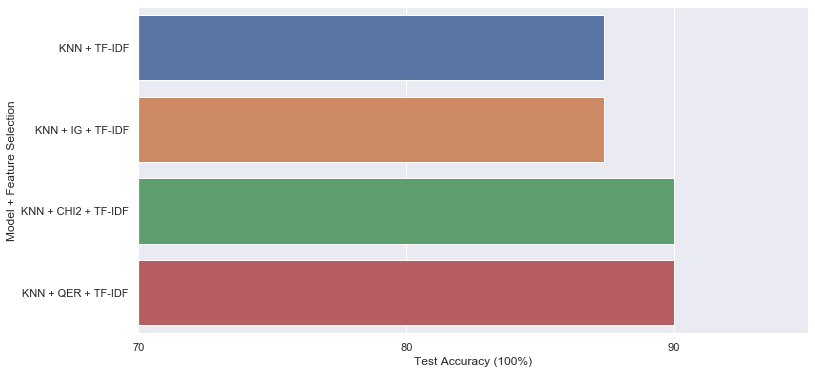

In [67]:
sns.set_style("whitegrid")
sns.set(rc={'figure.figsize':(12, 6)})

ax = sns.barplot(x='Test Accuracy', y='Model + Feature Selection', data=res_df)
ax.set_xlabel('Test Accuracy (100%)')
plt.xticks([i*10 for i in range(11)])
plt.xlim([70, 95])